In [76]:
import scanpy as sc
import scarches
from scarches.models.scpoli import scPoli
import scib
import os
import anndata
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score
import matplotlib.colors as colors

This notebook uses the level 2 annotations and retrains the scPoli model based on those annotations. Afterwards, the predictions are validated with protein surface measurements and consensus with expert. 

# Prepare adata

In [5]:
# comes from annotations_level2 notebooks "Altas_level1-noprototypes-allgenes-names-mse3-reload.h5ad" with level2 celltypes attached,
# which comes from "big-datasets-concat-ensembl-nodub-newfern_with6-aggr-all-sparse-scranlog1p-annot-nodoublets.h5ad"(pre pp) with level1 preds attached (which are only there from cells that were not removed in pp. So its the same number of cells than after pp)
adata = sc.read_h5ad("Altas_level1-noprototypes-allgenes-names-mse3-reload-level2.h5ad") 

In [22]:
adata_post_pp = sc.read_h5ad("big-datasets-concat-ensembl-nodub-newfern_with6-aggr-all-sparse-scranlog1p-annot-nodoublets-pp.h5ad")

In [28]:
# map celltypes level1 and level2 from adata (all genes, gene names) to the pp (HVG, PCA, checks, Ensembl ids)
# override old cell_type_level1, which has unknown because pre level1 integrations/mapping
adata_post_pp.obs["cell_type_level1"] = adata.obs["cell_type_level1_all"]
adata_post_pp.obs["cell_type_level2"] = adata.obs["cell_type_level2"]
del adata_post_pp.obs["atlas_key"]

In [30]:
# add new atlas_key
adata_post_pp.obs["atlas_key"] = ["query" if cell_type == "unknown" else "ref" for cell_type in adata_post_pp.obs["cell_type_level2"]]

In [31]:
adata_post_pp.write_h5ad("mse3-reload-hvg-level2-preint.h5ad")

In [2]:
adata = sc.read_h5ad("mse3-reload-hvg-level2-preint.h5ad")

In [3]:
# Subset where atlas_key is 'ref'
adata_ref = adata[adata.obs['atlas_key'] == 'ref'].copy()

# Subset where atlas_key is 'query'
adata_query = adata[adata.obs['atlas_key'] == 'query'].copy()

In [36]:
adata_ref.obs["cell_type_level2"].value_counts()

CD4 TEff         85317
CD8              14382
Inflammatory     10473
NK                9893
Monocyte          9292
SMC               9243
B cell            8985
Foamy             8763
Resident          4758
Fibroblast        4658
Fibromyocyte      3519
Proangiogenic     3210
EndoMT            2052
Mast cell         1857
CD4 Treg          1757
Plasma cell       1610
cDC2              1377
Intimal            539
cDC1               288
Lymphatic           75
CXCL8               66
Name: cell_type_level2, dtype: int64

In [37]:
adata_query.obs["cell_type_level2"].value_counts()

unknown    2521
Name: cell_type_level2, dtype: int64

# Train reference

In [38]:
early_stopping_kwargs = {
    "early_stopping_metric": "val_prototype_loss",
    "mode": "min",
    "threshold": 0,
    "patience": 20,
    "reduce_lr": True,
    "lr_patience": 13,
    "lr_factor": 0.1,
}
    
scpoli_model = scPoli(
adata=adata_ref,
condition_keys="sample",
cell_type_keys="cell_type_level2",
embedding_dims=10,
recon_loss='mse',
)

scpoli_model.train(
    n_epochs=50,
    pretraining_epochs=40,
    early_stopping_kwargs=early_stopping_kwargs,
    eta=5,
)

Embedding dictionary:
 	Num conditions: [61]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 2000 45 10
	Mean/Var Layer in/out: 45 10
Decoder Architecture:
	First Layer in, out and cond:  10 45 10
	Output Layer in/out:  45 2000 

Initializing dataloaders
Starting training
 |████████████████████| 100.0%  - val_loss:  182.55 - val_cvae_loss:  169.66 - val_prototype_loss:   12.90 - val_labeled_loss:    2.58


In [39]:
scpoli_model.save("models/refmse3-level2", overwrite=True)

# Train with query

In [40]:
scpoli_query = scPoli.load_query_data(
    adata=adata_query,
    reference_model=scpoli_model,
    labeled_indices=[],
)

Embedding dictionary:
 	Num conditions: [61]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 2000 45 10
	Mean/Var Layer in/out: 45 10
Decoder Architecture:
	First Layer in, out and cond:  10 45 10
	Output Layer in/out:  45 2000 



In [41]:
scpoli_query.train(
    n_epochs=50,
    pretraining_epochs=40,
    eta=10
)

The missing labels are: {'unknown'}
Therefore integer value of those labels is set to -1
The missing labels are: {'unknown'}
Therefore integer value of those labels is set to -1
The missing labels are: {'unknown'}
Therefore integer value of those labels is set to -1
The missing labels are: {'unknown'}
Therefore integer value of those labels is set to -1
Initializing dataloaders
Starting training
 |████████████████----| 80.0%  - val_loss:  214.27 - val_cvae_loss:  214.27
Initializing unlabeled prototypes with Leiden with an unknown number of  clusters.
Clustering succesful. Found 23 clusters.
 |████████████████████| 100.0%  - val_loss:  217.47 - val_cvae_loss:  217.47 - val_prototype_loss:    0.00 - val_unlabeled_loss:    0.23


In [42]:
scpoli_query.save("models/querymse3-level2", overwrite=True)

# Label transfer

In [43]:
adata_query.X = adata_query.X.astype("float32")

In [44]:
adata_ref.X = adata_ref.X.astype("float32")

In [45]:
results_dict = scpoli_query.classify(adata_query, scale_uncertainties=True)

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scarches/models/scpoli/scpoli_model.py:454: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at ../torch/csrc/utils/tensor_new.cpp:261.)
  c = torch.tensor(label_tensor, device=device).T


In [53]:
#get latent representation of reference data
scpoli_query.model.eval()
data_latent_source = scpoli_query.get_latent(
    adata_ref,
    mean=True
)

adata_latent_source = sc.AnnData(data_latent_source)
adata_latent_source.obs = adata_ref.obs.copy()

#get latent representation of query data
data_latent= scpoli_query.get_latent(
    adata_query,
    mean=True
)

adata_latent = sc.AnnData(data_latent)
adata_latent.obs = adata_query.obs.copy()

#get label annotations
adata_latent.obs['cell_type_pred'] = results_dict['cell_type_level2']['preds'].tolist()
adata_latent.obs['cell_type_uncert'] = results_dict['cell_type_level2']['uncert'].tolist()
#adata_latent.obs['classifier_outcome'] = (adata_latent.obs['cell_type_pred'] == adata_latent.obs['cell_type_level1'])

'''
#get prototypes
labeled_prototypes = scpoli_query.get_prototypes_info()
labeled_prototypes.obs['sample'] = 'labeled prototype'
unlabeled_prototypes = scpoli_query.get_prototypes_info(prototype_set='unlabeled')
unlabeled_prototypes.obs['sample'] = 'unlabeled prototype'


#join adatas
adata_latent_full = adata_latent_source.concatenate(
    [adata_latent, labeled_prototypes, unlabeled_prototypes],
    batch_key='query'
)
'''
#join adatas
adata_latent_full = adata_latent_source.concatenate(
    [adata_latent],
    batch_key='query'
)


adata_latent_full.obs['cell_type_pred'][adata_latent_full.obs['query'].isin(['0'])] = "Reference" #np.nan

/tmp/ipykernel_1301964/703832195.py:40: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  adata_latent_full = adata_latent_source.concatenate(
/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/pandas/core/algorithms.py:522: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps_array.dtype], [])
/tmp/ipykernel_1301964/703832195.py:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-ve

In [54]:
sc.pp.neighbors(adata_latent_full, n_neighbors=15)
sc.tl.umap(adata_latent_full)

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


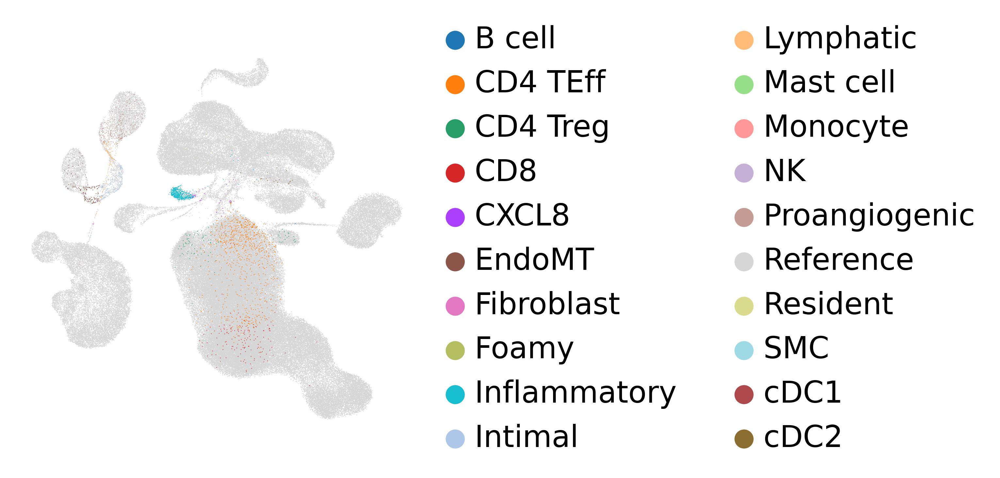

In [55]:
# Get unique categories from cell_type_pred
adata_latent_full.obs['cell_type_pred'] = adata_latent_full.obs['cell_type_pred'].astype('category')
categories = adata_latent_full.obs['cell_type_pred'].cat.categories

# Define the default Scanpy palette
default_palette = sc.pl.palettes.default_20

# Create a color palette, setting 'reference' to light gray and other categories to default colors
color_palette = {
    category: (0.84, 0.84, 0.84) if category == 'Reference' else default_palette[i % len(default_palette)]
    for i, category in enumerate(categories)
}

# Plot UMAP with custom color palette
sc.pl.umap(
    adata_latent_full,
    color='cell_type_pred',
    palette=color_palette,
    show=True,
    frameon=False,
    title = "",
    #save="_mse3_cell_types_with_ref.png"
)

In [56]:
adata_latent_full.obs['cell_type_level2_all'] = [
    row['cell_type_level2'] if row['cell_type_pred'] == 'Reference' else row['cell_type_pred'] 
    for _, row in adata_latent_full.obs.iterrows()
]

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/pandas/core/dtypes/cast.py:1641: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  return np.find_common_type(types, [])


/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


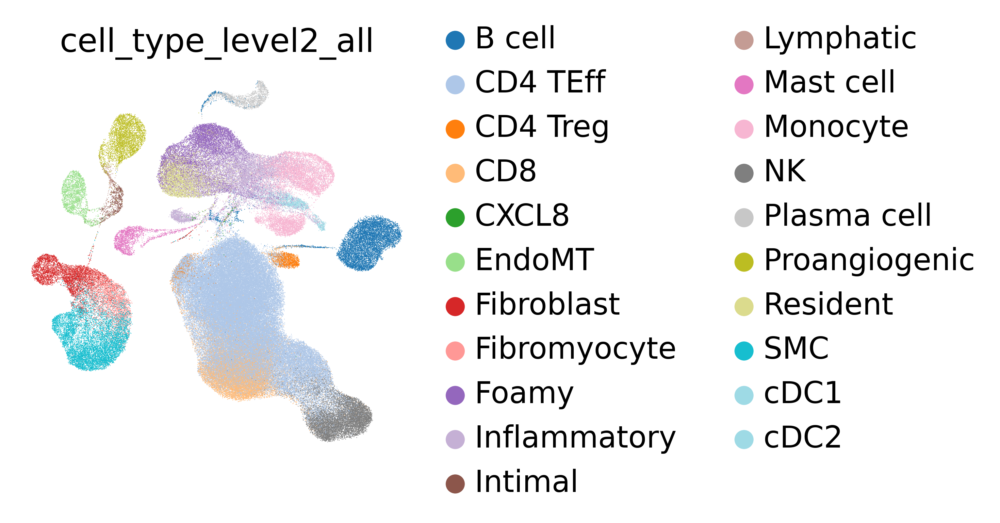

In [58]:
sc.pl.umap(
    adata_latent_full,
    color='cell_type_level2_all',
    show=True,
    frameon=False,
    palette = "tab20"
    #save = "cell_types_all.png"
)

# Reload for reproducibility

In [4]:
early_stopping_kwargs = {
    "early_stopping_metric": "val_prototype_loss",
    "mode": "min",
    "threshold": 0,
    "patience": 20,
    "reduce_lr": True,
    "lr_patience": 13,
    "lr_factor": 0.1,
}
    
scpoli_model = scPoli(
adata=adata_ref,
condition_keys="sample",
cell_type_keys="cell_type_level2",
embedding_dims=10,
recon_loss='mse',
)

Embedding dictionary:
 	Num conditions: [61]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 2000 45 10
	Mean/Var Layer in/out: 45 10
Decoder Architecture:
	First Layer in, out and cond:  10 45 10
	Output Layer in/out:  45 2000 



In [5]:
scpoli_query = scPoli.load_query_data(
    adata=adata_query,
    reference_model=scpoli_model,
    labeled_indices=[],
)

Embedding dictionary:
 	Num conditions: [61]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 2000 45 10
	Mean/Var Layer in/out: 45 10
Decoder Architecture:
	First Layer in, out and cond:  10 45 10
	Output Layer in/out:  45 2000 



In [6]:
adata_query.X = adata_query.X.astype("float32")

In [7]:
adata_ref.X = adata_ref.X.astype("float32")

In [8]:
scpoli_loaded = scpoli_query.load(dir_path="models/querymse3-level2", adata=adata_query)

AnnData object with n_obs × n_vars = 2521 × 2000
    obs: 'dataset', 'cell_type', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'sample', 'scDblFinder.sample', 'scDblFinder.class', 'scDblFinder.score', 'scDblFinder.weighted', 'scDblFinder.cxds_score', 'decontX_contamination', 'decontX_clusters', 'symptoms', 'n_genes', 'n_counts', 'size_factors', 'cell_type_level1', 'cell_type_level2', 'atlas_key', 'conditions_combined'
    var: 'original_gene_names', 'highly_variable'
    uns: 'log1p', 'neighbors', 'pca'
    obsm: 'X_pca'
    varm: 'PCs'
    layers: 'counts', 'raw_decontXcounts', 'uncorrected_counts'
    obsp: 'connectivities', 'distances'
Embedding dictionary:
 	Num conditions: [61]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 2000 45 10
	Mean/Var Layer in/out: 45 10
Decoder Architecture:
	First Layer in, out and cond:  10 45 10
	Output Layer in/out:  45 2000 



In [9]:
results_dict = scpoli_loaded.classify(adata_query, scale_uncertainties=True)

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scarches/models/scpoli/scpoli_model.py:454: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at ../torch/csrc/utils/tensor_new.cpp:261.)
  c = torch.tensor(label_tensor, device=device).T


In [10]:
#get latent representation of reference data
scpoli_loaded.model.eval()
data_latent_source = scpoli_loaded.get_latent(
    adata_ref,
    mean=True
)

adata_latent_source = sc.AnnData(data_latent_source)
adata_latent_source.obs = adata_ref.obs.copy()

#get latent representation of query data
data_latent= scpoli_loaded.get_latent(
    adata_query,
    mean=True
)

adata_latent = sc.AnnData(data_latent)
adata_latent.obs = adata_query.obs.copy()

#get label annotations
adata_latent.obs['cell_type_pred'] = results_dict['cell_type_level2']['preds'].tolist()
adata_latent.obs['cell_type_uncert'] = results_dict['cell_type_level2']['uncert'].tolist()
#adata_latent.obs['classifier_outcome'] = (adata_latent.obs['cell_type_pred'] == adata_latent.obs['cell_type_level1'])

'''
#get prototypes
labeled_prototypes = scpoli_query.get_prototypes_info()
labeled_prototypes.obs['sample'] = 'labeled prototype'
unlabeled_prototypes = scpoli_query.get_prototypes_info(prototype_set='unlabeled')
unlabeled_prototypes.obs['sample'] = 'unlabeled prototype'


#join adatas
adata_latent_full = adata_latent_source.concatenate(
    [adata_latent, labeled_prototypes, unlabeled_prototypes],
    batch_key='query'
)
'''
#join adatas
adata_latent_full = adata_latent_source.concatenate(
    [adata_latent],
    batch_key='query'
)


adata_latent_full.obs['cell_type_pred'][adata_latent_full.obs['query'].isin(['0'])] = "Reference" #np.nan

/tmp/ipykernel_1305307/847680913.py:40: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  adata_latent_full = adata_latent_source.concatenate(
/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/pandas/core/algorithms.py:522: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps_array.dtype], [])
/tmp/ipykernel_1305307/847680913.py:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-ve

In [11]:
sc.pp.neighbors(adata_latent_full, n_neighbors=15)
sc.tl.umap(adata_latent_full)

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


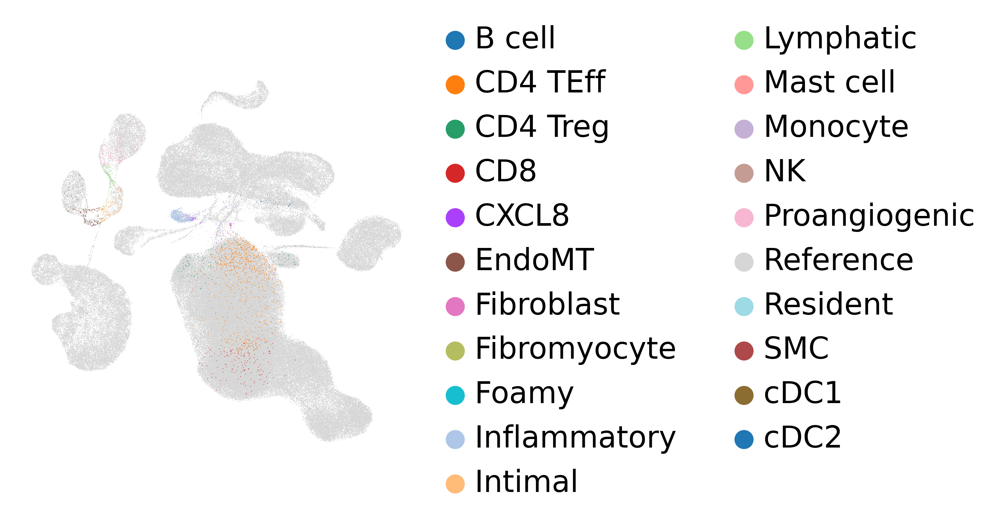

In [12]:
# Get unique categories from cell_type_pred
adata_latent_full.obs['cell_type_pred'] = adata_latent_full.obs['cell_type_pred'].astype('category')
categories = adata_latent_full.obs['cell_type_pred'].cat.categories

# Define the default Scanpy palette
default_palette = sc.pl.palettes.default_20

# Create a color palette, setting 'reference' to light gray and other categories to default colors
color_palette = {
    category: (0.84, 0.84, 0.84) if category == 'Reference' else default_palette[i % len(default_palette)]
    for i, category in enumerate(categories)
}

# Plot UMAP with custom color palette
sc.pl.umap(
    adata_latent_full,
    color='cell_type_pred',
    palette=color_palette,
    show=True,
    frameon=False,
    title = "",
    #save="_mse3_cell_types_with_ref.png"
)

In [13]:
adata_latent_full.obs['cell_type_level2_all'] = [
    row['cell_type_level2'] if row['cell_type_pred'] == 'Reference' else row['cell_type_pred'] 
    for _, row in adata_latent_full.obs.iterrows()
]

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/pandas/core/dtypes/cast.py:1641: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  return np.find_common_type(types, [])


/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


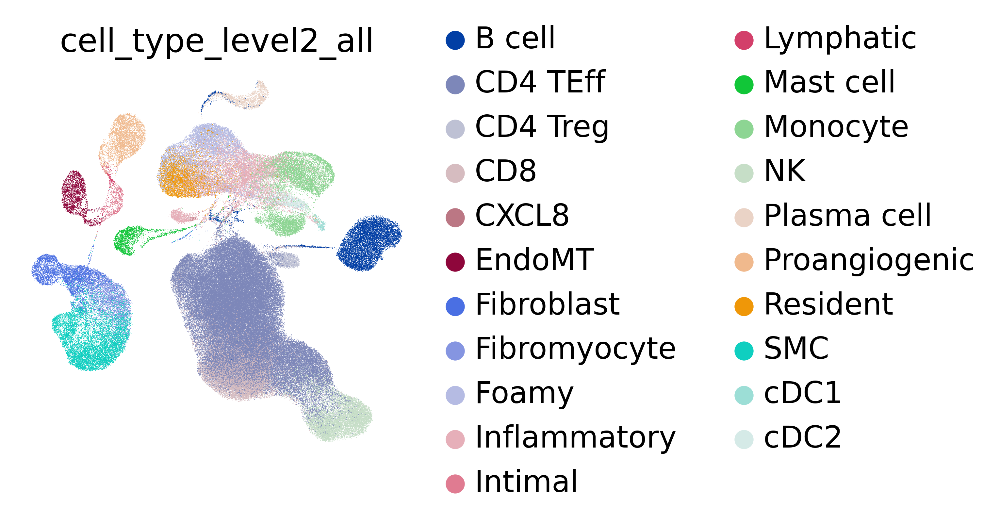

In [15]:
sc.pl.umap(
    adata_latent_full,
    color='cell_type_level2_all',
    show=True,
    frameon=False,
    #save = "cell_types_all.png"
)

In [16]:
adata_latent_full.write_h5ad("Altas_level2-noprototypes-mse-3-reload.h5ad")

## Plots for figure in paper

In [94]:
adata_latent_full = sc.read_h5ad("Altas_level2-noprototypes-mse-3-reload.h5ad")

In [95]:
adata_latent_full.obs

,dataset,cell_type,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,sample,scDblFinder.sample,scDblFinder.class,scDblFinder.score,...,n_counts,size_factors,cell_type_level1,cell_type_level2,atlas_key,conditions_combined,cell_type_pred,cell_type_uncert,query,cell_type_level2_all
car02_d_AAATGGATCGAGTGGA.1-0,Roche,CD8 T,647.0,1273.0,78.0,6.127258,2_Roche,2,singlet,0.507475,...,NaN,0.306150,NK,CD4 TEff,ref,2_Roche,Reference,NaN,0,CD4 TEff
car02_d_AAGGAATGTCGTTGGC.1-0,Roche,Inf MΦ,2881.0,9727.0,1564.0,16.078955,2_Roche,2,singlet,0.563011,...,NaN,2.219434,Macrophage,Resident,ref,2_Roche,Reference,NaN,0,Resident
car02_d_AATGGCTTCTTCCAGC.1-0,Roche,TREM2 MΦ,4906.0,43494.0,3031.0,6.968777,2_Roche,2,doublet,0.675130,...,NaN,9.472461,Macrophage,Foamy,ref,2_Roche,Reference,NaN,0,Foamy
car02_d_ACCTACCGTTTACTGG.1-0,Roche,Plasma cell,335.0,8015.0,3.0,0.037430,2_Roche,2,singlet,0.501177,...,NaN,0.099273,Plasma cell,Plasma cell,ref,2_Roche,Reference,NaN,0,Plasma cell
car02_d_ACCTGAAGTCATCCCT.1-0,Roche,Mast cell,1113.0,2843.0,219.0,7.703130,2_Roche,2,singlet,0.520772,...,NaN,0.092680,Mast cell,Mast cell,ref,2_Roche,Reference,NaN,0,Mast cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Fresh_DTAN_4047_TAGGCATGTTCTGTTT-1-1,Jaiswal,CD4+ T-cells,514.0,802.0,55.0,6.857855,2_Jaiswal,2,singlet,0.005501,...,802.0,0.233214,T cell,unknown,query,2_Jaiswal,CD4 TEff,0.136874,1,CD4 TEff
Fresh_DTAN_4047_TATCAGGTCGCCGTGA-1-1,Jaiswal,Plasmacytoid DCs,2460.0,9757.0,248.0,2.541765,2_Jaiswal,2,singlet,0.184365,...,9756.0,2.292063,DC,unknown,query,2_Jaiswal,Inflammatory,0.252621,1,Inflammatory
Fresh_DTAN_4047_TCAGCTCTCAGATAAG-1-1,Jaiswal,Plasmacytoid DCs,2802.0,10745.0,190.0,1.768264,2_Jaiswal,2,singlet,0.065983,...,10739.0,2.702644,DC,unknown,query,2_Jaiswal,Inflammatory,0.221849,1,Inflammatory
Fresh_DTAN_4047_TGCACCTAGCAGGCTA-1-1,Jaiswal,Plasmacytoid DCs,2054.0,6122.0,265.0,4.328651,2_Jaiswal,2,singlet,0.012353,...,6120.0,1.651174,DC,unknown,query,2_Jaiswal,Inflammatory,0.158606,1,Inflammatory


In [96]:
#rename dict to make level 2 celltypes long names
rename_dict = {
    "CD4 TEff": "CD4 TEff T cell",
    "CD8": "CD8 T cell",
    "Inflammatory": "Inflammatory Macrophage",
    "NK" : "NK",
    "Monocyte": "Monocyte",
    "SMC": "Smooth Muscle Cell",
    "B cell": "B cell",
    "Foamy": "Foamy Macrophage",
    "Resident": "Resident Macrophage",
    "Fibroblast": "Fibroblast",
    "Proangiogenic": "Proangiogenic EC",
    "Fibromyocyte": "Fibromyocyte",
    "EndoMT": "EndoMT EC",
    "Mast cell": "Mast cell",
    "CD4 Treg" : "CD4 Treg T cell",
    "Plasma cell": "Plasma cell",
    "cDC2": "cDC2 Dendritic cell",
    "cDC1": "cDC1 Dendritic cell",
    "CXCL8": "CXCL8 T cell",
    "Lymphatic": "Lymphatic EC",
    "Intimal": "Intimal EC"
}

In [97]:
# rename level2s in prediction column with reference
adata_latent_full.obs['cell_type_level2_all'] = adata_latent_full.obs['cell_type_level2_all'].map(rename_dict)

In [98]:
#add new column level 1

mapping_dict = {
    "CD4 TEff T cell": "T cell",
    "CD8 T cell": "T cell",
    "Inflammatory Macrophage": "Macrophage",
    "NK": "NK",
    "Monocyte": "Monocyte",
    "Smooth Muscle Cell": "Smooth Muscle Cell",
    "B cell": "B cell",
    "Foamy Macrophage": "Macrophage",
    "Resident Macrophage": "Macrophage",
    "Fibroblast": "Fibroblast",
    "Fibromyocyte": "Fibromyocyte",
    "Proangiogenic EC": "EC",
    "EndoMT EC": "EC",
    "CD4 Treg T cell": "T cell",
    "Mast cell": "Mast cell",
    "Plasma cell": "Plasma cell",
    "cDC2 Dendritic cell": "DC",
    "Intimal EC": "EC",
    "cDC1 Dendritic cell": "DC",
    "Lymphatic EC": "EC",
    "CXCL8 T cell": "T cell"
}

In [99]:
adata_latent_full.obs['cell_type_level1'] = adata_latent_full.obs["cell_type_level2_all"].map(mapping_dict).fillna("no map")

In [100]:
adata_latent_full.obs

,dataset,cell_type,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,sample,scDblFinder.sample,scDblFinder.class,scDblFinder.score,...,n_counts,size_factors,cell_type_level1,cell_type_level2,atlas_key,conditions_combined,cell_type_pred,cell_type_uncert,query,cell_type_level2_all
car02_d_AAATGGATCGAGTGGA.1-0,Roche,CD8 T,647.0,1273.0,78.0,6.127258,2_Roche,2,singlet,0.507475,...,NaN,0.306150,T cell,CD4 TEff,ref,2_Roche,Reference,NaN,0,CD4 TEff T cell
car02_d_AAGGAATGTCGTTGGC.1-0,Roche,Inf MΦ,2881.0,9727.0,1564.0,16.078955,2_Roche,2,singlet,0.563011,...,NaN,2.219434,Macrophage,Resident,ref,2_Roche,Reference,NaN,0,Resident Macrophage
car02_d_AATGGCTTCTTCCAGC.1-0,Roche,TREM2 MΦ,4906.0,43494.0,3031.0,6.968777,2_Roche,2,doublet,0.675130,...,NaN,9.472461,Macrophage,Foamy,ref,2_Roche,Reference,NaN,0,Foamy Macrophage
car02_d_ACCTACCGTTTACTGG.1-0,Roche,Plasma cell,335.0,8015.0,3.0,0.037430,2_Roche,2,singlet,0.501177,...,NaN,0.099273,Plasma cell,Plasma cell,ref,2_Roche,Reference,NaN,0,Plasma cell
car02_d_ACCTGAAGTCATCCCT.1-0,Roche,Mast cell,1113.0,2843.0,219.0,7.703130,2_Roche,2,singlet,0.520772,...,NaN,0.092680,Mast cell,Mast cell,ref,2_Roche,Reference,NaN,0,Mast cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Fresh_DTAN_4047_TAGGCATGTTCTGTTT-1-1,Jaiswal,CD4+ T-cells,514.0,802.0,55.0,6.857855,2_Jaiswal,2,singlet,0.005501,...,802.0,0.233214,T cell,unknown,query,2_Jaiswal,CD4 TEff,0.136874,1,CD4 TEff T cell
Fresh_DTAN_4047_TATCAGGTCGCCGTGA-1-1,Jaiswal,Plasmacytoid DCs,2460.0,9757.0,248.0,2.541765,2_Jaiswal,2,singlet,0.184365,...,9756.0,2.292063,Macrophage,unknown,query,2_Jaiswal,Inflammatory,0.252621,1,Inflammatory Macrophage
Fresh_DTAN_4047_TCAGCTCTCAGATAAG-1-1,Jaiswal,Plasmacytoid DCs,2802.0,10745.0,190.0,1.768264,2_Jaiswal,2,singlet,0.065983,...,10739.0,2.702644,Macrophage,unknown,query,2_Jaiswal,Inflammatory,0.221849,1,Inflammatory Macrophage
Fresh_DTAN_4047_TGCACCTAGCAGGCTA-1-1,Jaiswal,Plasmacytoid DCs,2054.0,6122.0,265.0,4.328651,2_Jaiswal,2,singlet,0.012353,...,6120.0,1.651174,Macrophage,unknown,query,2_Jaiswal,Inflammatory,0.158606,1,Inflammatory Macrophage


In [101]:
color_palette_level1 = {
    'T cell': '#3182bd',                       # blue for all T cell types
    'Macrophage': '#8c564b',                   # brown for all macrophages
    'Plasma cell': '#9467bd',                  # muted purple
    'Mast cell': '#d62728',                    # red
    'NK': '#98df8a',                           # light green
    'Fibromyocyte': '#f7b6d2',                 # pastel pink
    "Smooth Muscle Cell": '#7b4173',           # deeper purple
    'Fibroblast': '#e377c2',                   # bright pink
    'B cell': '#2ca02c',                       # green
    'DC': '#807dba',                           # violet for dendritic cells
    'EC': '#fdae6b',                           # orange for all endothelial cells  
    'Monocyte': '#c7c7c7'                      # lighter gray
}

color_palette_level2 = {
    'B cell': '#2ca02c',                       # green
    
    'CD4 TEff T cell': '#1E90FF',              # Dodger Blue
    'CD4 Treg T cell': '#40E0D0',              # Turquoise
    'CD8 T cell': '#0047AB',                   # Cobalt Blue
    'CXCL8 T cell': '#483D8B',                 # Dark Slate Blue
    
    'EndoMT EC': '#FFD700',                    # Gold
    'Intimal EC': '#FFDAB9',                   # Peach Puff
    'Lymphatic EC': '#FFBF00',                 # Amber
    'Proangiogenic EC': '#ED9121',             # Carrot Orange
    
    'Fibroblast': '#e377c2',                   # bright pink
    'Fibromyocyte': '#f7b6d2',                 # pastel pink
    'Smooth Muscle Cell': '#7b4173',           # deeper purple
    
    'Foamy Macrophage': '#c49c94',             # light brown
    'Inflammatory Macrophage': '#8b4513',      # saddle brown
    'Resident Macrophage': '#8c564b',          # brown
    
    'Mast cell': '#d62728',                    # red
    
    'Monocyte': '#7f7f7f',                     # medium gray
    
    'NK': '#98df8a',                           # light green
    
    'Plasma cell': '#9467bd',                  # muted purple
    
    'cDC1 Dendritic cell': '#9e9ac8',          # light violet
    'cDC2 Dendritic cell': '#6a51a3',          # dark violet
    
    'Reference': '#c7c7c7'                     # lighter gray
}

In [102]:
dataset_renaming_dict = {
    "Roche": "Pauli",
    "Emoto_ACS": "Emoto",
    "Emoto_SAP": "Emoto"
}

In [103]:
adata_latent_full.obs['dataset'] = adata_latent_full.obs['dataset'].map(lambda x: dataset_renaming_dict.get(x, x))

In [104]:
origin_mapping_dict = {
    'Pauli':"carotid",
    'Alsaigh':"carotid",
    'Fernandez':"carotid",
    'Wirka':"coronary",
    'Emoto':"coronary",
    'Chowdhury':"coronary",
    'Pan': "carotid",
    'Dib':"carotid",
    'Slysz':"carotid",
    'Slysz_femoral':"femoral",
    'Jaiswal':"carotid"
}

In [105]:
adata_latent_full.obs['origin'] = adata_latent_full.obs['dataset'].map(origin_mapping_dict).fillna("no map")

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


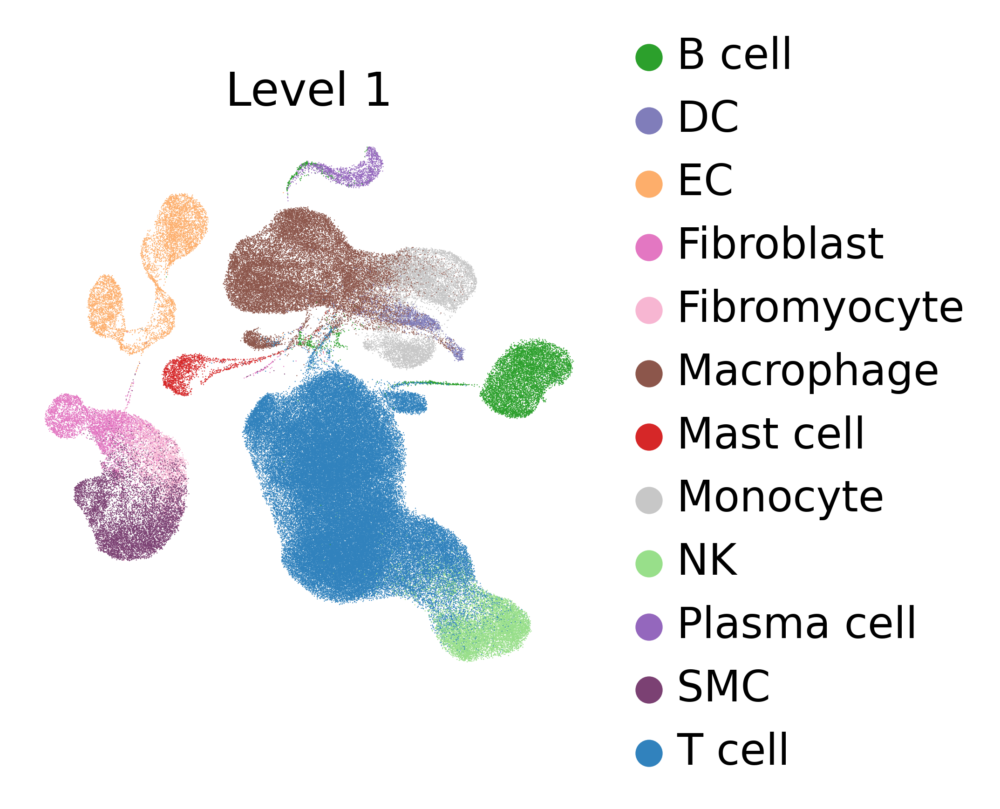

In [37]:
sc.pl.umap(
    adata_latent_full,
    color='cell_type_level1',
    show=True,
    frameon=False,
    palette = color_palette_level1,
    vmax=1,
    title="Level 1",
    save="_mse3-reload_level1.png"
)

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


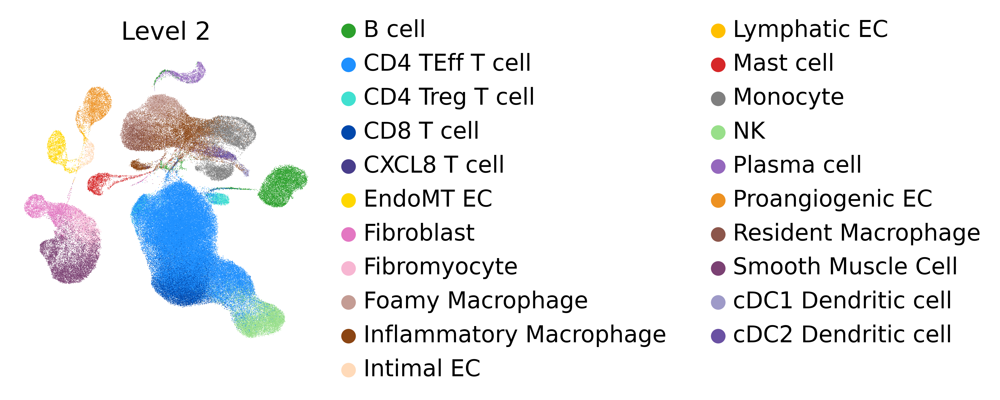

In [20]:
sc.pl.umap(
    adata_latent_full,
    color='cell_type_level2_all',
    show=True,
    frameon=False,
    palette = color_palette_level2,
    vmax=1,
    title="Level 2",
    save="_mse3-reload_level2-newlabels.pdf"
)

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


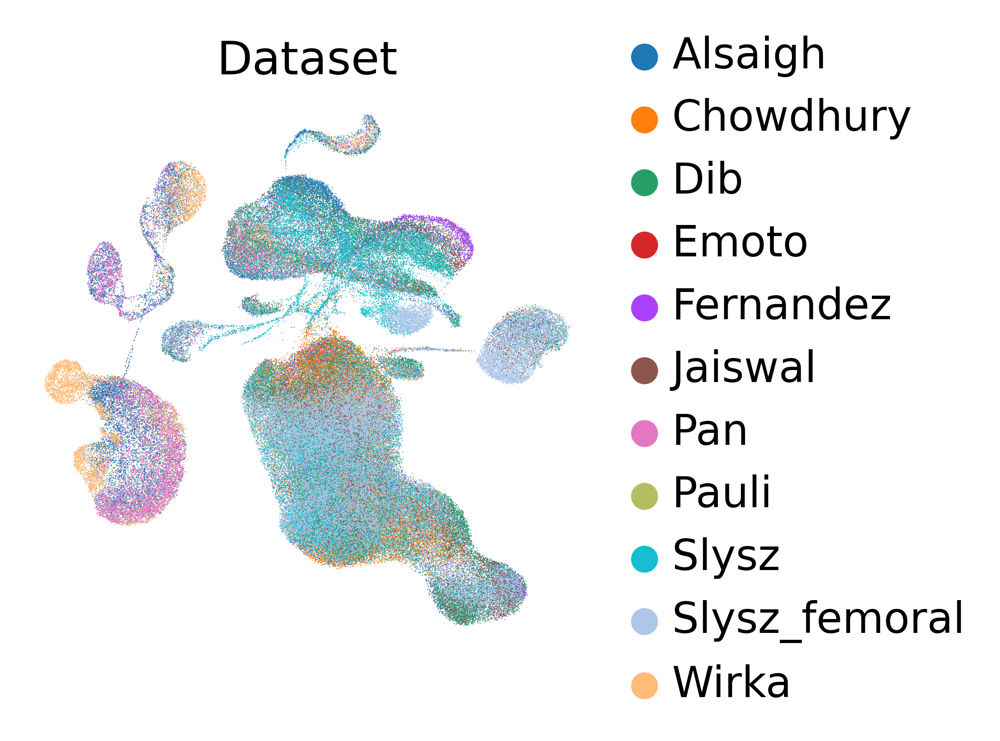

In [38]:
sc.pl.umap(
    adata_latent_full,
    color='dataset',
    show=True,
    frameon=False,
    #cmap='magma',
    vmax=1,
    title="Dataset",
    save="_mse3-reload_dataset.png"
)

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


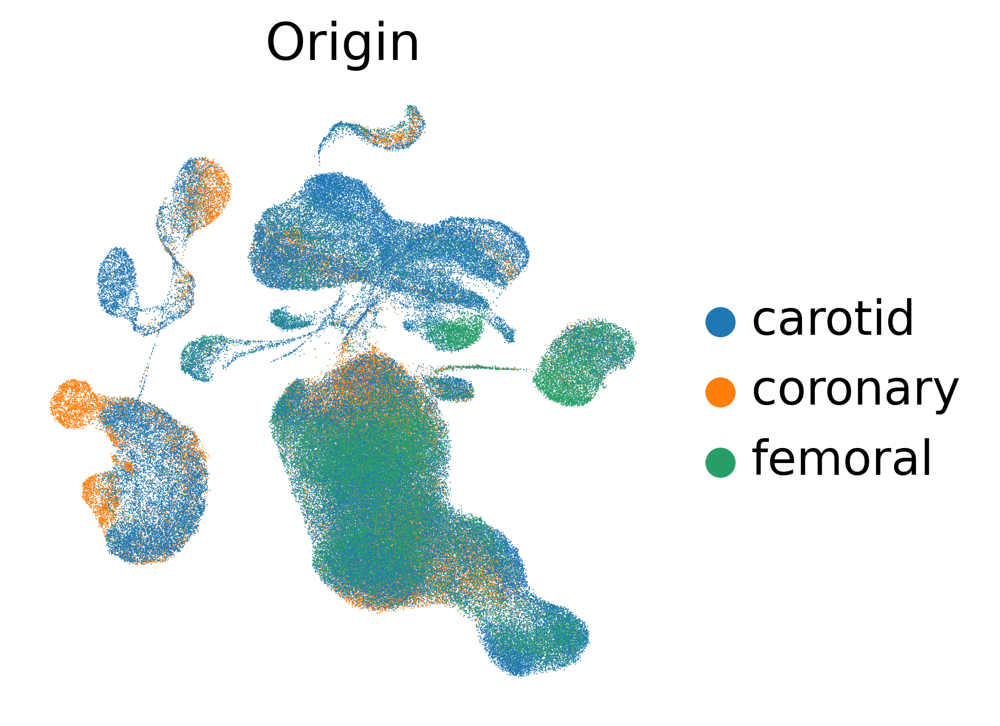

In [39]:
sc.pl.umap(
    adata_latent_full,
    color='origin',
    show=True,
    frameon=False,
    #cmap='magma',
    vmax=1,
    title="Origin",
    save="_mse3-reload_origin.png"
)

In [10]:
(adata_latent_full.obs['cell_type_uncert']>0.8).sum()

26

In [42]:
(adata_latent_full.obs['cell_type_level2_all']=='CXCL8 T cell').sum()

133

# Valdiate annotations

In [60]:
adata_latent_full = sc.read_h5ad("Altas_level2-noprototypes-allgenes-names-mse3-reload.h5ad")
#cell_type_level2_all are pred (only few unknowns, rest set) level2 celltypes and cell_type_level1 are level 1 preds from earlier. In all genes version it is corrected.

In [54]:
adata_latent_full.obs

,dataset,cell_type,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,sample,scDblFinder.sample,scDblFinder.class,scDblFinder.score,scDblFinder.weighted,scDblFinder.cxds_score,decontX_contamination,decontX_clusters,symptoms,n_genes,n_counts,size_factors,cell_type_level1,cell_type_level2
car02_d_AAATGGATCGAGTGGA.1,Roche,CD8 T,647.0,1273.0,78.0,6.127258,2_Roche,2,singlet,0.507475,1.000000,0.014949,0.000529,2-1,NaN,NaN,NaN,0.306150,T cell,CD4 TEff
car02_d_AAGGAATGTCGTTGGC.1,Roche,Inf MΦ,2881.0,9727.0,1564.0,16.078955,2_Roche,2,singlet,0.563011,1.000000,0.126022,0.024352,2-2,NaN,NaN,NaN,2.219434,Macrophage,Resident
car02_d_AATGGCTTCTTCCAGC.1,Roche,TREM2 MΦ,4906.0,43494.0,3031.0,6.968777,2_Roche,2,doublet,0.675130,0.973690,0.390259,0.000323,2-2,NaN,NaN,NaN,9.472461,Macrophage,Foamy
car02_d_ACCTACCGTTTACTGG.1,Roche,Plasma cell,335.0,8015.0,3.0,0.037430,2_Roche,2,singlet,0.501177,1.000000,0.002354,0.000003,2-2,NaN,NaN,NaN,0.099273,Plasma cell,Plasma cell
car02_d_ACCTGAAGTCATCCCT.1,Roche,Mast cell,1113.0,2843.0,219.0,7.703130,2_Roche,2,singlet,0.520772,1.000000,0.041544,0.753178,2-2,NaN,NaN,NaN,0.092680,Mast cell,Mast cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Fresh_DTAN_4047_TTTGTCAAGGACTGGT-1,Jaiswal,CD8+ T-cells,1254.0,3224.0,108.0,3.349876,2_Jaiswal,2,singlet,0.043425,0.733000,0.009147,0.026254,2-4,not stated,1254.0,3224.0,0.763210,T cell,CD4 TEff
Fresh_DTAN_4047_TTTGTCAGTAGGCTGA-1,Jaiswal,CD4+ T-cells,1189.0,4195.0,126.0,3.003576,2_Jaiswal,2,singlet,0.108291,0.677275,0.024988,0.003678,2-5,not stated,1189.0,4194.0,0.774646,T cell,CD4 TEff
Fresh_DTAN_4047_TTTGTCATCAACACAC-1,Jaiswal,CD8+ T-cells,1236.0,3195.0,54.0,1.690141,2_Jaiswal,2,singlet,0.106050,0.705021,0.037757,0.054584,2-7,not stated,1236.0,3194.0,0.782079,NK,NK
Fresh_DTAN_4047_TTTGTCATCATAACCG-1,Jaiswal,B-cells,984.0,2843.0,91.0,3.200844,2_Jaiswal,2,singlet,0.002852,0.311139,0.000223,0.015132,2-9,not stated,984.0,2840.0,0.553815,B cell,B cell


In [57]:
adata_latent_full.obs["cell_type_level1"].value_counts()

cell_type_level1
T cell          102741
Macrophage       24533
NK                9901
Monocyte          9293
SMC               9244
B cell            8987
EC                6589
Fibroblast        4663
Fibromyocyte      3520
Mast cell         1861
DC                1693
Plasma cell       1610
Name: count, dtype: int64

In [58]:
#add new column called level2tolevel1

mapping_dict = {
    "CD4 TEff": "T cell",
    "CD8": "T cell",
    "Inflammatory": "Macrophage",
    "NK": "NK",
    "Monocyte": "Monocyte",
    "SMC": "SMC",
    "B cell": "B cell",
    "Foamy": "Macrophage",
    "Resident": "Macrophage",
    "Fibroblast": "Fibroblast",
    "Fibromyocyte": "Fibromyocyte",
    "Proangiogenic": "EC",
    "EndoMT": "EC",
    "CD4 Treg": "T cell",
    "Mast cell": "Mast cell",
    "Plasma cell": "Plasma cell",
    "cDC2": "DC",
    "Intimal": "EC",
    "cDC1": "DC",
    "Lymphatic": "EC",
    "CXCL8": "T cell"
}

## Fernandez

In [61]:
fernandez_adata = adata_latent_full[adata_latent_full.obs["sample"] == "6_Fernandez"]

In [62]:
path = "/lustre/groups/epigenereg01/workspace/projects/Plaque-atlas/data/Fernandez/GSE224273/GSE224273_RAW/"

In [63]:
adata_sample6 = sc.read_10x_mtx(path + "Sample6", var_names='gene_symbols')

In [64]:
# Create a boolean mask for rows where gene_ids do NOT start with "ENSG"
mask = ~adata_sample6.var['gene_ids'].str.startswith('ENSG')

# Filter the DataFrame using the mask
adata_filtered = adata_sample6[:, mask]

In [65]:
# Step 1: Remove the 'gene_ids' column
adata_filtered.var.drop(columns=['gene_ids'], inplace=True)

# Step 2 & 3: Remove '-1' suffix and add '-cite' suffix to the index
adata_filtered.var.index = [idx.replace('-1', '') for idx in adata_filtered.var.index]

In [66]:
surface_markers = list(adata_filtered.var_names)

In [67]:
fernandez_adata.obs.index = [barcode[:-2] for barcode in fernandez_adata.obs.index]

In [68]:
adata_filtered2 = adata_filtered[fernandez_adata.obs.index]

In [69]:
cite_adata = adata_filtered2.copy()
annot_adata = fernandez_adata.copy()

In [70]:
# Step 1: Intersect barcodes to find common cells in both datasets
common_barcodes = cite_adata.obs_names.intersection(annot_adata.obs_names)

# Filter both datasets to only include common cells
filtered_cite_adata = cite_adata[common_barcodes, :]
filtered_annot_adata = annot_adata[common_barcodes, :]

# Step 2: Transfer the necessary columns from filtered_annot_adata to filtered_cite_adata
# Assuming common_barcodes ensures matching order, check if additional sorting is necessary
filtered_cite_adata.obs['cell_type_level1'] = filtered_annot_adata.obs['cell_type_level1']
filtered_cite_adata.obs['cell_type_level2'] = filtered_annot_adata.obs['cell_type_level2']

/var/tmp/ipykernel_1094655/1243383711.py:10: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  filtered_cite_adata.obs['cell_type_level1'] = filtered_annot_adata.obs['cell_type_level1']


In [71]:
final_adata = filtered_cite_adata.copy()

In [72]:
surface_markers_curated = {
    "B cell": ["CD19", "CD24"],
    "DC": ["CD11c", "CD1c", "CD206"],
    "Macrophage": ["CD14", "CD11b", "CD11c", "CD206", "CD33", "CD64", "HLA-DR"],
    "Monocyte": ["CD11b", "CD33"], 
    "NK": ["CD16", "CD56"],
    "Plasma cell": ["CD27", "CD38"],
    "T cell": ["CD3", "CD4", "CD8"]
}

In [73]:
#remove cell types from dataset where no markers are available: EC, Fibroblasts, Fibromyocytes, Mast cell, Plasma , SMC
# List of cell types to remove
cell_types_to_remove = ["Fibroblast", "Fibromyocyte", "SMC", "Mast cell", "EC"]

# Filtering the data to remove specified cell types
final_adata = final_adata[~final_adata.obs["cell_type_level1"].isin(cell_types_to_remove)]

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No dat

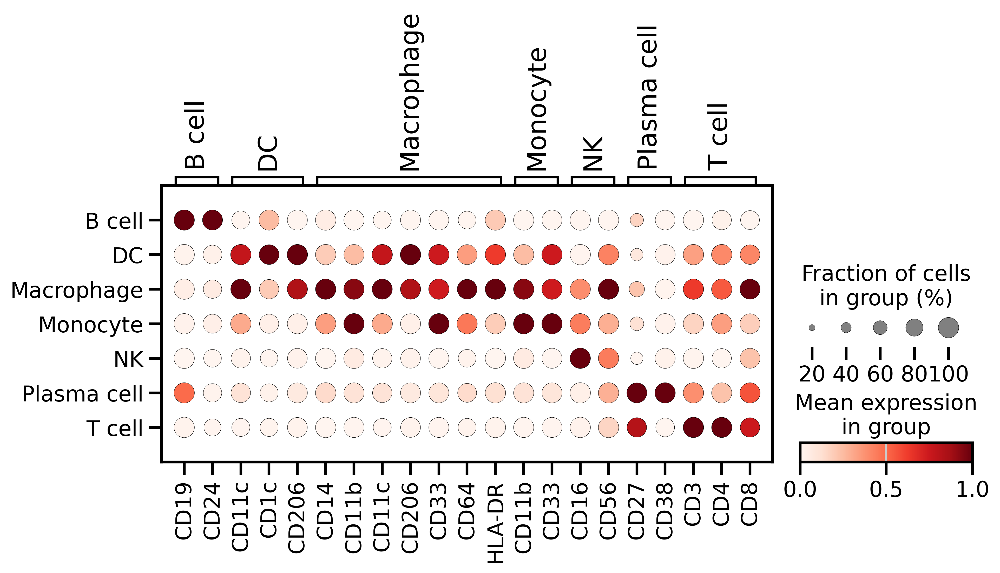

In [75]:
dp = sc.pl.dotplot(
    final_adata,
    groupby="cell_type_level1",
    var_names=surface_markers_curated,
    standard_scale="var",  # standard scale: normalize each gene to range from 0 to 1
    return_fig = True,
    figsize = (10,3.5)
    #save="surface_markers_fernandez_dendo.png"
)
dp.legend(width=2.2)
#dp.show()
dp.savefig("figures/dotplot_fernandezCITE-mse3-reload-level2.pdf")

## Wirka

In [44]:
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score
import matplotlib.colors as colors

In [86]:
adata = sc.read_h5ad("Altas_level2-noprototypes-allgenes-names-mse3-reload.h5ad")

In [87]:
adata_wirka = adata[adata.obs["dataset"]=="Wirka"].copy()

In [88]:
adata_wirka.obs["cell_type"].value_counts()

cell_type
Fibroblast A    2239
EC              1832
Fibromyocyte     923
Inf MΦ           821
VSMC             802
CD4 T            704
Pericyte A       669
Pericyte B       543
B cell           526
Plasma cell      512
TREM2 MΦ         500
DC               345
Fibroblast B     244
NK               232
Neuron           214
Mono             206
CD8 T            206
Res MΦ           195
Mast              43
Name: count, dtype: int64

In [89]:
wirka_mapping_dict_ehsan = {
    "T cell": ["CD4 T", "CD8 T"],
    "B cell": ["B cell"],
    "Fibroblast": ["Fibroblast A", "Fibroblast B"],
    "Fibromyocyte": ["Fibromyocyte"],
    "Monocyte" : ["Mono"],
    "EC": ["EC"],
    "Macrophage": ["TREM2 MΦ", "Inf MΦ", "Res MΦ"],
    "NK": ["NK"],
    "SMC": ["VSMC"],
    "Mast cell": ["Mast"],
    "Plasma cell": ["Plasma cell"],
    "unknown": ["non-MΦ Myeloid", "Proliferating cells", "Pericyte A" , "Pericyte B", "Neuron", ]
}

In [90]:
cell_types_wirka = list(adata_wirka.obs["cell_type"].values)

In [91]:
# Invert the wirka_mapping_dict
inverted_wirka_mapping = {v: k for k, values in wirka_mapping_dict_ehsan.items() for v in values}

# Map each cell type in cell_types_roche, keeping the original value if it's not in the mapping
mapped_cell_types_wirka = [inverted_wirka_mapping.get(cell_type, cell_type) for cell_type in cell_types_wirka]

In [92]:
cell_types_pred_wirka = list(adata_wirka.obs["cell_type_level1"].values)

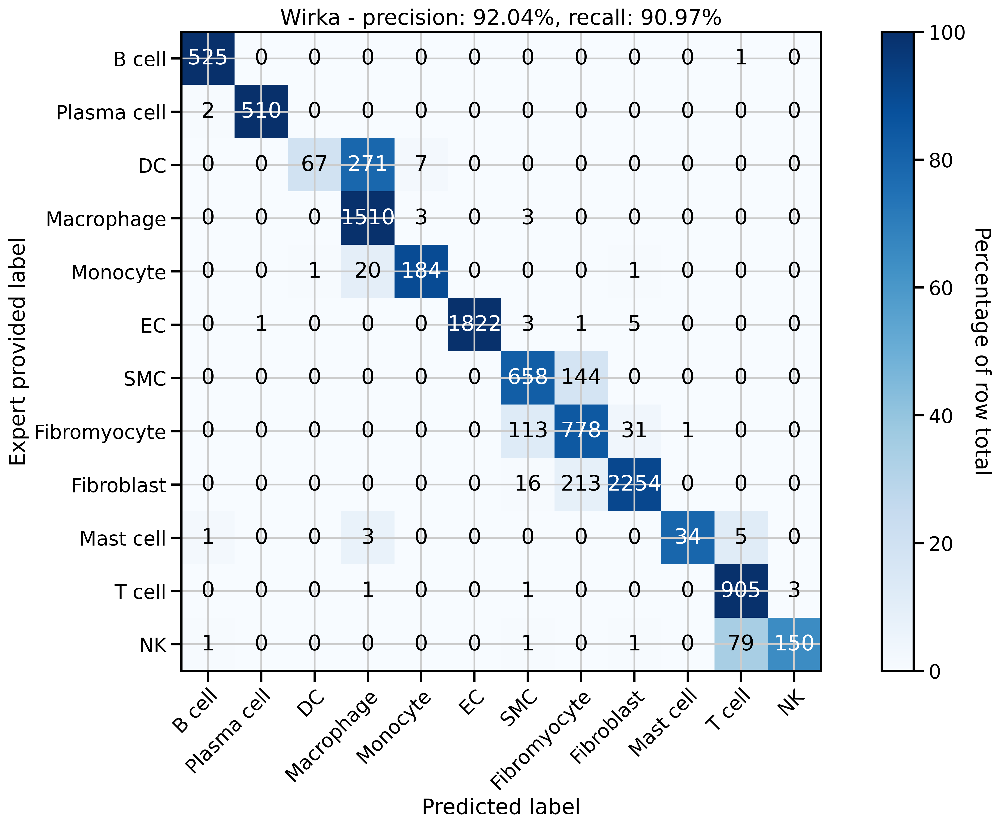

In [93]:
# Define the new order for the cell types
new_order = ["B cell", "Plasma cell", "DC", "Macrophage", "Monocyte", "EC", "SMC", "Fibromyocyte", "Fibroblast", "Mast cell", "T cell", "NK"]

# Find the intersection of unique cell types in both lists and filter them according to the new order
common_cell_types_wirka = set(mapped_cell_types_wirka) & set(cell_types_pred_wirka)
common_cell_types_wirka = [ct for ct in new_order if ct in common_cell_types_wirka]

# Filter both lists to include only indices where the cell type of the true labels is in the common set
# and the corresponding predicted cell type is also in the common set.
common_indices = [i for i, ct in enumerate(mapped_cell_types_wirka) if ct in common_cell_types_wirka and cell_types_pred_wirka[i] in common_cell_types_wirka]

# Use the common indices to filter both lists
filtered_mapped_cell_types_wirka = [mapped_cell_types_wirka[i] for i in common_indices]
filtered_cell_types_pred_wirka = [cell_types_pred_wirka[i] for i in common_indices]

# Calculate the confusion matrix and accuracy using the new order
conf_matrix_wirka = confusion_matrix(filtered_mapped_cell_types_wirka, filtered_cell_types_pred_wirka, labels=common_cell_types_wirka)
accuracy_wirka = accuracy_score(filtered_mapped_cell_types_wirka, filtered_cell_types_pred_wirka)

# Calculate precision and recall for each class and overall
precision_wirka = precision_score(filtered_mapped_cell_types_wirka, filtered_cell_types_pred_wirka, labels=common_cell_types_wirka, average=None)
recall_wirka = recall_score(filtered_mapped_cell_types_wirka, filtered_cell_types_pred_wirka, labels=common_cell_types_wirka, average=None)
overall_precision_wirka = precision_score(filtered_mapped_cell_types_wirka, filtered_cell_types_pred_wirka, average='weighted')
overall_recall_wirka = recall_score(filtered_mapped_cell_types_wirka, filtered_cell_types_pred_wirka, average='weighted')

# Calculate percentages for coloring (per row)
row_sums = conf_matrix_wirka.sum(axis=1, keepdims=True)
conf_matrix_percentages = conf_matrix_wirka / row_sums * 100

# Plotting the confusion matrix
fig, ax = plt.subplots(figsize=(15, 10))
norm = colors.Normalize(vmin=0, vmax=100)  # Set vmax to 100 for percentage
im = ax.imshow(conf_matrix_percentages, interpolation='nearest', cmap=plt.cm.Blues, norm=norm)
cbar = ax.figure.colorbar(im, ax=ax)
cbar.ax.set_ylabel('Percentage of row total', rotation=-90, va="bottom")

ax.set(xticks=np.arange(len(common_cell_types_wirka)),
       yticks=np.arange(len(common_cell_types_wirka)),
       xticklabels=common_cell_types_wirka, yticklabels=common_cell_types_wirka,
       title=f'Wirka - precision: {overall_precision_wirka:.2%}, recall: {overall_recall_wirka:.2%}',
       ylabel='Expert provided label',
       xlabel='Predicted label')

plt.setp(ax.get_xticklabels(), rotation=45, ha="right", rotation_mode="anchor")

# Add text annotations (showing the original count)
for i in range(conf_matrix_wirka.shape[0]):
    for j in range(conf_matrix_wirka.shape[1]):
        ax.text(j, i, format(conf_matrix_wirka[i, j], 'd'),
                ha="center", va="center",
                color="white" if conf_matrix_percentages[i, j] > 50 else "black")

fig.tight_layout()
plt.savefig("figures/conf_matrix_common_wirka_mse3-reload-level2-new-labels-row-percentage-color.pdf")
#plt.show()

## Emoto

In [77]:
adata = sc.read_h5ad("Altas_level2-noprototypes-allgenes-names-mse3-reload.h5ad")

In [78]:
adata_emoto = adata[(adata.obs["dataset"] == "Emoto_ACS") | (adata.obs["dataset"] == "Emoto_SAP")].copy()

In [79]:
adata_emoto

AnnData object with n_obs × n_vars = 1624 × 28488
    obs: 'dataset', 'cell_type', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'sample', 'scDblFinder.sample', 'scDblFinder.class', 'scDblFinder.score', 'scDblFinder.weighted', 'scDblFinder.cxds_score', 'decontX_contamination', 'decontX_clusters', 'symptoms', 'n_genes', 'n_counts', 'size_factors', 'cell_type_level1', 'cell_type_level2'
    var: 'original_gene_names', 'ensembl_id'
    uns: 'log1p'
    layers: 'raw_decontXcounts', 'rounded_corrected_counts', 'uncorrected_counts'

In [80]:
adata_emoto.obs["cell_type"].value_counts()

cell_type
CD8 T           490
CD4 T           436
Mono            195
Naive B         104
TREM2 MΦ         94
NK               86
Inf MΦ           59
Memory B         46
unknown          41
DC               28
Res MΦ           23
Undetermined     16
Mast              6
Name: count, dtype: int64

In [81]:
emoto_mapping_dict_ehsan = {
    "T cell": ["CD4 T", "CD8 T"],
    "B cell": ["Naive B", "Memory B"],
    "Monocyte" : ["Mono"],
    "Macrophage": ["TREM2 MΦ", "Inf MΦ", "Res MΦ"],
    "NK": ["NK"],
    "Mast cell": ["Mast"],
    "unknown": ["unknown", "Undetermined"]
}

In [82]:
cell_types_emoto = list(adata_emoto.obs["cell_type"].values)

In [83]:
# Invert the emoto_mapping_dict
inverted_emoto_mapping = {v: k for k, values in emoto_mapping_dict_ehsan.items() for v in values}

# Map each cell type in cell_types_roche, keeping the original value if it's not in the mapping
mapped_cell_types_emoto = [inverted_emoto_mapping.get(cell_type, cell_type) for cell_type in cell_types_emoto]

In [84]:
cell_types_pred_emoto = list(adata_emoto.obs["cell_type_level1"].values)

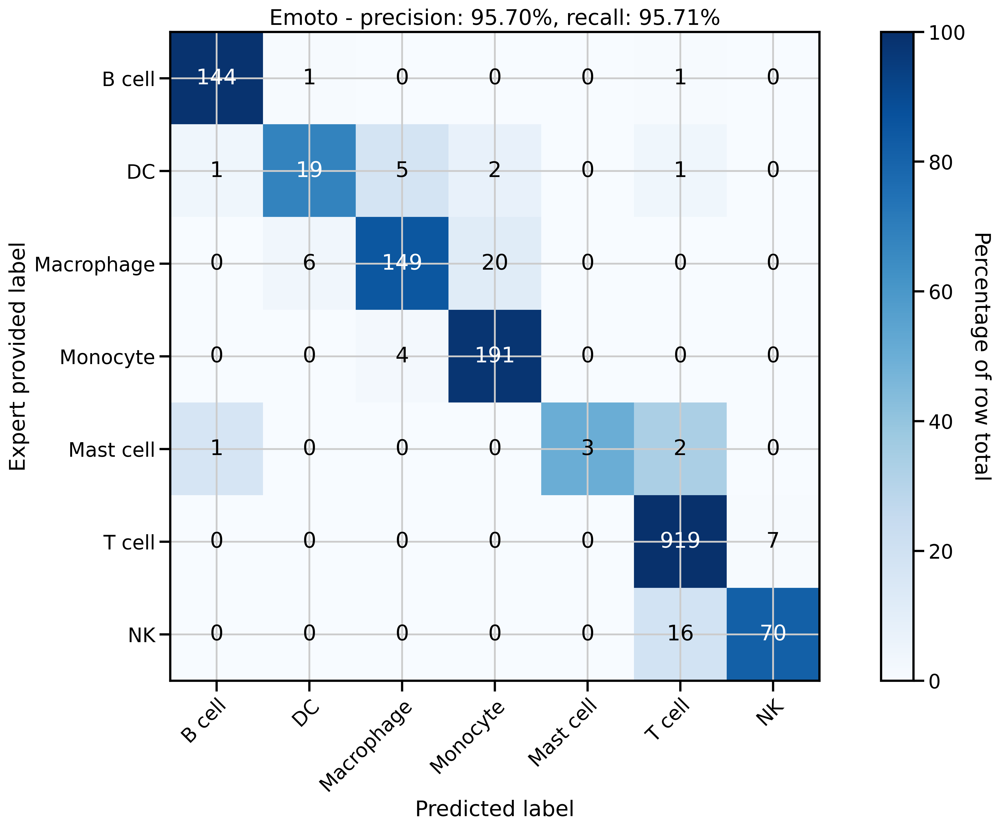

In [85]:
# Define the new order for the cell types
new_order = ["B cell", "DC", "Macrophage", "Monocyte", "Mast cell", "T cell", "NK"]

# Find the intersection of unique cell types in both lists and filter them according to the new order
common_cell_types_emoto = set(mapped_cell_types_emoto) & set(cell_types_pred_emoto)
common_cell_types_emoto = [ct for ct in new_order if ct in common_cell_types_emoto]

# Filter both lists to include only indices where the cell type of the true labels is in the common set
# and the corresponding predicted cell type is also in the common set.
common_indices = [i for i, ct in enumerate(mapped_cell_types_emoto) if ct in common_cell_types_emoto and cell_types_pred_emoto[i] in common_cell_types_emoto]

# Use the common indices to filter both lists
filtered_mapped_cell_types_emoto = [mapped_cell_types_emoto[i] for i in common_indices]
filtered_cell_types_pred_emoto = [cell_types_pred_emoto[i] for i in common_indices]

# Calculate the confusion matrix and accuracy using the new order
conf_matrix_emoto = confusion_matrix(filtered_mapped_cell_types_emoto, filtered_cell_types_pred_emoto, labels=common_cell_types_emoto)
accuracy_emoto = accuracy_score(filtered_mapped_cell_types_emoto, filtered_cell_types_pred_emoto)

# Calculate precision and recall for each class and overall
precision_emoto = precision_score(filtered_mapped_cell_types_emoto, filtered_cell_types_pred_emoto, labels=common_cell_types_emoto, average=None)
recall_emoto = recall_score(filtered_mapped_cell_types_emoto, filtered_cell_types_pred_emoto, labels=common_cell_types_emoto, average=None)
overall_precision_emoto = precision_score(filtered_mapped_cell_types_emoto, filtered_cell_types_pred_emoto, average='weighted')
overall_recall_emoto = recall_score(filtered_mapped_cell_types_emoto, filtered_cell_types_pred_emoto, average='weighted')

# Calculate percentages for coloring (per row)
row_sums = conf_matrix_emoto.sum(axis=1, keepdims=True)
conf_matrix_percentages = conf_matrix_emoto / row_sums * 100

# Plotting the confusion matrix
fig, ax = plt.subplots(figsize=(15, 10))
norm = colors.Normalize(vmin=0, vmax=100)  # Set vmax to 100 for percentage
im = ax.imshow(conf_matrix_percentages, interpolation='nearest', cmap=plt.cm.Blues, norm=norm)
cbar = ax.figure.colorbar(im, ax=ax)
cbar.ax.set_ylabel('Percentage of row total', rotation=-90, va="bottom")

ax.set(xticks=np.arange(len(common_cell_types_emoto)),
       yticks=np.arange(len(common_cell_types_emoto)),
       xticklabels=common_cell_types_emoto, yticklabels=common_cell_types_emoto,
       title=f'Emoto - precision: {overall_precision_emoto:.2%}, recall: {overall_recall_emoto:.2%}',
       ylabel='Expert provided label',
       xlabel='Predicted label')

plt.setp(ax.get_xticklabels(), rotation=45, ha="right", rotation_mode="anchor")

# Add text annotations (showing the original count)
for i in range(conf_matrix_emoto.shape[0]):
    for j in range(conf_matrix_emoto.shape[1]):
        ax.text(j, i, format(conf_matrix_emoto[i, j], 'd'),
                ha="center", va="center",
                color="white" if conf_matrix_percentages[i, j] > 50 else "black")

fig.tight_layout()
plt.savefig("figures/conf_matrix_common_emoto_mse3-reload-level2-new-label-row-percentage-color.pdf")
#plt.show()

## Jaiswal

In [28]:
adata = sc.read_h5ad("Altas_level2-noprototypes-allgenes-names-mse3-reload.h5ad")

In [29]:
adata_jaiswal = adata[(adata.obs["dataset"] == "Jaiswal")].copy()

In [30]:
Jaiswal_mapping_dict = {
    "T cell": ["CD4+ T-cells", "CD8+ T-cells"],
    "Macrophage": ["Foam cells", "Inflammatory macrophages", "MHC-hi macrophages", "LYVE1+ TR macrophages"],
    "NK": ["Active NK cells", "Resting NK cells"],
    "B cell": ["B-cells"],
    "DC": ["cDCs", "Plasmacytoid DCs"],
    "Monocyte": ["CD16+ monocytes"],
    "unknown": ["Basophils"],
    "Plasma cell": ["Plasma cells"]
}

In [31]:
cell_types_jaiswal = list(adata_jaiswal.obs["cell_type"].values)

In [32]:
# Invert the Jaiswal_mapping_dict
inverted_Jaiswal_mapping = {v: k for k, values in Jaiswal_mapping_dict.items() for v in values}

# Map each cell type in cell_types_jaiswal, keeping the original value if it's not in the mapping
mapped_cell_types_jaiswal = [inverted_Jaiswal_mapping.get(cell_type, cell_type) for cell_type in cell_types_jaiswal]

In [33]:
cell_types_pred_jaiswal = list(adata_jaiswal.obs["cell_type_level1"].values)

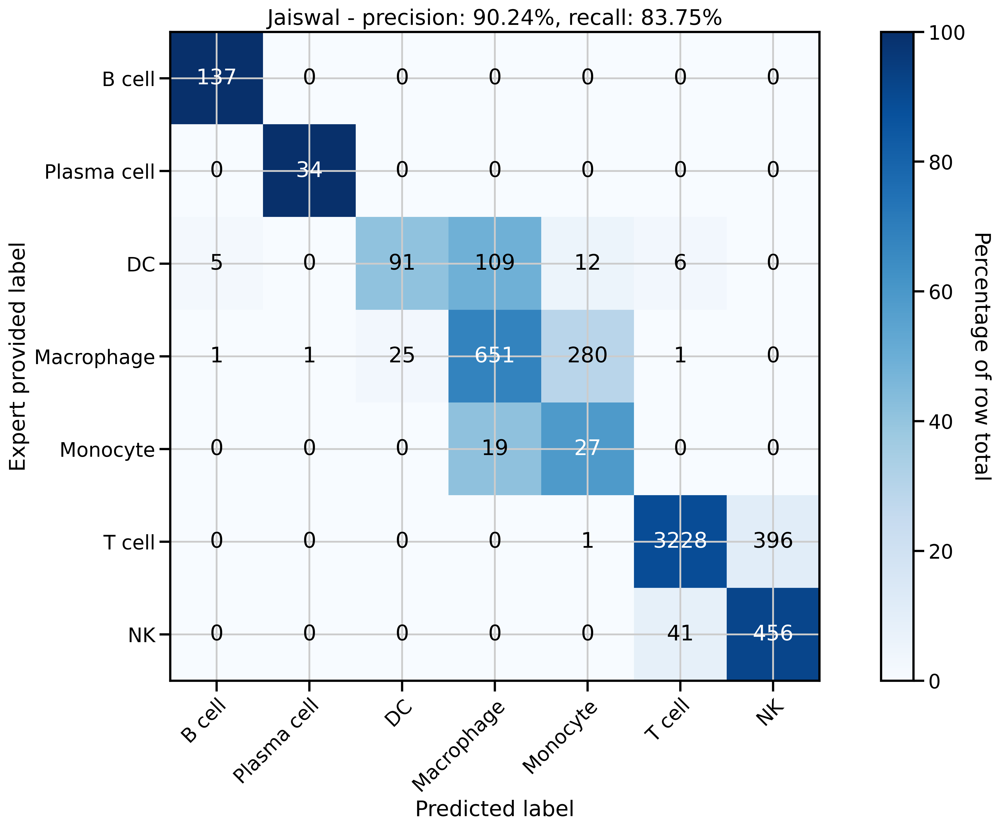

In [34]:
# Define the new order for the cell types
new_order = ["B cell", "Plasma cell", "DC", "Macrophage", "Monocyte", "T cell", "NK"]

# Find the intersection of unique cell types in both lists and filter them according to the new order
common_cell_types_jaiswal = set(mapped_cell_types_jaiswal) & set(cell_types_pred_jaiswal)
common_cell_types_jaiswal = [ct for ct in new_order if ct in common_cell_types_jaiswal]

# Filter both lists to include only indices where the cell type of the true labels is in the common set
# and the corresponding predicted cell type is also in the common set.
common_indices = [i for i, ct in enumerate(mapped_cell_types_jaiswal) if ct in common_cell_types_jaiswal and cell_types_pred_jaiswal[i] in common_cell_types_jaiswal]

# Use the common indices to filter both lists
filtered_mapped_cell_types_jaiswal = [mapped_cell_types_jaiswal[i] for i in common_indices]
filtered_cell_types_pred_jaiswal = [cell_types_pred_jaiswal[i] for i in common_indices]

# Calculate the confusion matrix and accuracy using the new order
conf_matrix_jaiswal = confusion_matrix(filtered_mapped_cell_types_jaiswal, filtered_cell_types_pred_jaiswal, labels=common_cell_types_jaiswal)
accuracy_jaiswal = accuracy_score(filtered_mapped_cell_types_jaiswal, filtered_cell_types_pred_jaiswal)

# Calculate precision and recall for each class and overall
precision_jaiswal = precision_score(filtered_mapped_cell_types_jaiswal, filtered_cell_types_pred_jaiswal, labels=common_cell_types_jaiswal, average=None)
recall_jaiswal = recall_score(filtered_mapped_cell_types_jaiswal, filtered_cell_types_pred_jaiswal, labels=common_cell_types_jaiswal, average=None)
overall_precision_jaiswal = precision_score(filtered_mapped_cell_types_jaiswal, filtered_cell_types_pred_jaiswal, average='weighted')
overall_recall_jaiswal = recall_score(filtered_mapped_cell_types_jaiswal, filtered_cell_types_pred_jaiswal, average='weighted')

# Calculate percentages for coloring (per row)
row_sums = conf_matrix_jaiswal.sum(axis=1, keepdims=True)
conf_matrix_percentages = conf_matrix_jaiswal / row_sums * 100

# Plotting the confusion matrix
fig, ax = plt.subplots(figsize=(15, 10))
norm = colors.Normalize(vmin=0, vmax=100)  # Set vmax to 100 for percentage
im = ax.imshow(conf_matrix_percentages, interpolation='nearest', cmap=plt.cm.Blues, norm=norm)
cbar = ax.figure.colorbar(im, ax=ax)
cbar.ax.set_ylabel('Percentage of row total', rotation=-90, va="bottom")

ax.set(xticks=np.arange(len(common_cell_types_jaiswal)),
       yticks=np.arange(len(common_cell_types_jaiswal)),
       xticklabels=common_cell_types_jaiswal, yticklabels=common_cell_types_jaiswal,
       title=f'Jaiswal - precision: {overall_precision_jaiswal:.2%}, recall: {overall_recall_jaiswal:.2%}',
       ylabel='Expert provided label',
       xlabel='Predicted label')

plt.setp(ax.get_xticklabels(), rotation=45, ha="right", rotation_mode="anchor")

# Add text annotations (showing the original count)
for i in range(conf_matrix_jaiswal.shape[0]):
    for j in range(conf_matrix_jaiswal.shape[1]):
        ax.text(j, i, format(conf_matrix_jaiswal[i, j], 'd'),
                ha="center", va="center",
                color="white" if conf_matrix_percentages[i, j] > 50 else "black")

fig.tight_layout()
plt.savefig("figures/conf_matrix_common_jaiswal_mse3-reload-level2-new-label-row-percentage-color.pdf")
#plt.show()

## Pauli

In [21]:
adata = sc.read_h5ad("Altas_level2-noprototypes-allgenes-names-mse3-reload.h5ad")

In [22]:
adata_roche = adata[(adata.obs["dataset"] == "Roche")].copy()

In [23]:
Roche_mapping_dict = {
    "T cell": ["CD4 T", "CD8 T"],
    "B cell": ["B cell"],
    "Fibroblast": ["Fibroblast"],
    "Fibromyocyte": ["Fibromyocyte"],
    "EC": ["EC A", "EC B"],
    "Macrophage": ["TREM2 MΦ", "Inf MΦ", "Res MΦ"],
    "NK": ["NK"],
    "SMC": ["VSMC A", "VSMC B"],
    "Mast cell": ["Mast cell"],
    "Plasma cell": ["Plasma cell"],
    "unknown": ["non-MΦ Myeloid", "Proliferating cells" ]
}

In [24]:
cell_types_roche = list(adata_roche.obs["cell_type"].values)

In [25]:
# Invert the Roche_mapping_dict
inverted_Roche_mapping = {v: k for k, values in Roche_mapping_dict.items() for v in values}

# Map each cell type in cell_types_roche, keeping the original value if it's not in the mapping
mapped_cell_types_roche = [inverted_Roche_mapping.get(cell_type, cell_type) for cell_type in cell_types_roche]

In [26]:
cell_types_pred_roche = list(adata_roche.obs["cell_type_level1"].values)

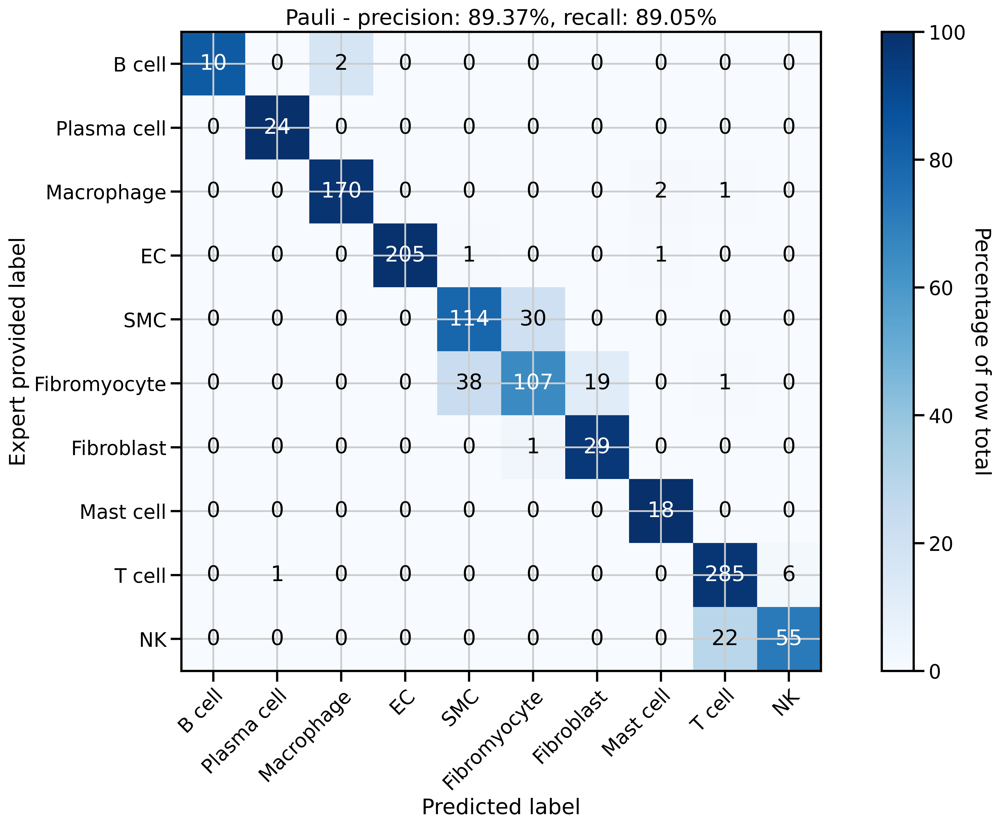

In [27]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import colors
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score

# Define the new order for the cell types
new_order = ["B cell", "Plasma cell", "Macrophage", "EC", "SMC", "Fibromyocyte", "Fibroblast", "Mast cell", "T cell", "NK"]

# Find the intersection of unique cell types in both lists and filter them according to the new order
common_cell_types_roche = set(mapped_cell_types_roche) & set(cell_types_pred_roche)
common_cell_types_roche = [ct for ct in new_order if ct in common_cell_types_roche]

# Filter both lists to include only indices where the cell type of the true labels is in the common set
# and the corresponding predicted cell type is also in the common set.
common_indices = [i for i, ct in enumerate(mapped_cell_types_roche) if ct in common_cell_types_roche and cell_types_pred_roche[i] in common_cell_types_roche]

# Use the common indices to filter both lists
filtered_mapped_cell_types_roche = [mapped_cell_types_roche[i] for i in common_indices]
filtered_cell_types_pred_roche = [cell_types_pred_roche[i] for i in common_indices]

# Calculate the confusion matrix and accuracy using the new order
conf_matrix_roche = confusion_matrix(filtered_mapped_cell_types_roche, filtered_cell_types_pred_roche, labels=common_cell_types_roche)
accuracy_roche = accuracy_score(filtered_mapped_cell_types_roche, filtered_cell_types_pred_roche)

# Calculate precision and recall for each class and overall
precision_roche = precision_score(filtered_mapped_cell_types_roche, filtered_cell_types_pred_roche, labels=common_cell_types_roche, average=None)
recall_roche = recall_score(filtered_mapped_cell_types_roche, filtered_cell_types_pred_roche, labels=common_cell_types_roche, average=None)
overall_precision_roche = precision_score(filtered_mapped_cell_types_roche, filtered_cell_types_pred_roche, average='weighted')
overall_recall_roche = recall_score(filtered_mapped_cell_types_roche, filtered_cell_types_pred_roche, average='weighted')

# Calculate percentages for coloring (per row)
row_sums = conf_matrix_roche.sum(axis=1, keepdims=True)
conf_matrix_percentages = conf_matrix_roche / row_sums * 100

# Plotting the confusion matrix
fig, ax = plt.subplots(figsize=(15, 10))
norm = colors.Normalize(vmin=0, vmax=100)  # Set vmax to 100 for percentage
im = ax.imshow(conf_matrix_percentages, interpolation='nearest', cmap=plt.cm.Blues, norm=norm)
cbar = ax.figure.colorbar(im, ax=ax)
cbar.ax.set_ylabel('Percentage of row total', rotation=-90, va="bottom")

ax.set(xticks=np.arange(len(common_cell_types_roche)),
       yticks=np.arange(len(common_cell_types_roche)),
       xticklabels=common_cell_types_roche, yticklabels=common_cell_types_roche,
       title=f'Pauli - precision: {overall_precision_roche:.2%}, recall: {overall_recall_roche:.2%}',
       ylabel='Expert provided label',
       xlabel='Predicted label')

plt.setp(ax.get_xticklabels(), rotation=45, ha="right", rotation_mode="anchor")

# Add text annotations (showing the original count)
for i in range(conf_matrix_roche.shape[0]):
    for j in range(conf_matrix_roche.shape[1]):
        ax.text(j, i, format(conf_matrix_roche[i, j], 'd'),
                ha="center", va="center",
                color="white" if conf_matrix_percentages[i, j] > 50 else "black")

fig.tight_layout()
plt.savefig("figures/conf_matrix_common_roche_mse3-reload-level2-new-labels-row-percentage-color.pdf")
#plt.show()

# Transfer label to all genes

In [3]:
adata_post_int = sc.read_h5ad("Altas_level2-noprototypes-mse-3-reload.h5ad")

In [4]:
adata_post_int.obs_names = adata_post_int.obs_names.str[:-2]

In [5]:
adata_pre_pp = sc.read_h5ad("big-datasets-concat-ensembl-nodub-newfern_with6-aggr-all-sparse-scranlog1p-annot-nodoublets.h5ad")

In [6]:
# Assuming 'obs_names' is the column that represents your observations. Should be just the post int obs
common_obs = adata_pre_pp.obs_names[adata_pre_pp.obs_names.isin(adata_post_int.obs_names)]

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/pandas/core/algorithms.py:522: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps_array.dtype], [])


In [8]:
# Create a subset of adata_pre_pp for easier handling
adata_pre_pp_subset = adata_pre_pp[common_obs]

In [11]:
# Transfer "cell_type_level1_all" data
#adata_pre_pp_subset.obs["cell_type_level1"] = adata_post_int.obs["cell_type_level1_all"].reindex(common_obs)
adata_pre_pp_subset.obs["cell_type_level2"] = adata_post_int.obs["cell_type_level2_all"].reindex(common_obs)

/tmp/ipykernel_1853147/1771957681.py:4: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_pre_pp_subset.obs["cell_type_level2"] = adata_post_int.obs["cell_type_level2_all"].reindex(common_obs)


In [13]:
adata_pre_pp_subset.obs["cell_type_level2"].value_counts()

CD4 TEff         86199
CD8              14548
Inflammatory     11006
NK                9901
Monocyte          9293
SMC               9244
B cell            8987
Foamy             8764
Resident          4763
Fibroblast        4663
Fibromyocyte      3520
Proangiogenic     3488
EndoMT            2197
CD4 Treg          1861
Mast cell         1861
Plasma cell       1610
cDC2              1404
Intimal            698
cDC1               289
Lymphatic          206
CXCL8              133
Name: cell_type_level2, dtype: int64

In [66]:
#add new column level 1
mapping_dict = {
    "CD4 TEff": "T cell",
    "CD8": "T cell",
    "Inflammatory": "Macrophage",
    "NK": "NK",
    "Monocyte": "Monocyte",
    "SMC": "SMC",
    "B cell": "B cell",
    "Foamy": "Macrophage",
    "Resident": "Macrophage",
    "Fibroblast": "Fibroblast",
    "Fibromyocyte": "Fibromyocyte",
    "Proangiogenic": "EC",
    "EndoMT": "EC",
    "CD4 Treg": "T cell",
    "Mast cell": "Mast cell",
    "Plasma cell": "Plasma cell",
    "cDC2": "DC",
    "Intimal": "EC",
    "cDC1": "DC",
    "Lymphatic": "EC",
    "CXCL8": "T cell"
}

In [16]:
adata_pre_pp_subset.obs['cell_type_level1'] = adata_pre_pp_subset.obs["cell_type_level2"].map(mapping_dict).fillna("no map")

In [18]:
adata_pre_pp_subset.var['ensembl_id'] = adata_pre_pp_subset.var.index
adata_pre_pp_subset.var.index = adata_pre_pp_subset.var['original_gene_names']

In [20]:
adata_pre_pp_subset.write_h5ad("Altas_level2-noprototypes-allgenes-names-mse3-reload.h5ad") # main atlas file

In [59]:
# now for embedding
adata_post_int = sc.read_h5ad("Altas_level2-noprototypes-mse-3-reload.h5ad")

In [61]:
adata_post_int.obs_names = adata_post_int.obs_names.str[:-2]

In [64]:
# delete old ones
del adata_post_int.obs["cell_type_level1"]
del adata_post_int.obs["cell_type_level2"]

In [65]:
adata_post_int.obs["cell_type_level2"] = adata_post_int.obs["cell_type_level2_all"]

In [67]:
adata_post_int.obs['cell_type_level1'] = adata_post_int.obs["cell_type_level2"].map(mapping_dict).fillna("no map")

In [71]:
del adata_post_int.obs["cell_type_level2_all"]

In [73]:
adata_post_int.write_h5ad("Altas_level2-noprototypes-mse-3-reload-embedding.h5ad")

## all cells level 1 dotplot (infered from level2)

In [2]:
level1_marker = {
    'Bcell': ['CD79A', 'CD79B', 'MS4A1', 'IGKC', 'CD22', 'FCER2'],
    'DC': ['CLEC10A', 'FCER1A', 'CD1C', 'HLA-DRA', 'HLA-DRB1'],
    'EC': ['PECAM1', 'VWF', 'FABP4', 'CLDN5', 'IFI27', 'ECSCR', 'DYSF', 'CD34', 'COL4A1', 'COL4A2', 'SPARCL1', 'PLVAP', 'MPZL2', 'SULF1', 'EDN1'],
    'Fibroblast': ['LUM', 'DCN', 'COL1A1', 'COL1A2', 'FBLN1', 'THY1', "C3", "C7"],
    'Fibromyocyte': ['FN1', 'LUM', 'TNFRSF11B', 'ACTA2', "TCF21"],
    'Macrophage': ['C1QA', 'C1QB', 'C1QC', 'CD74', 'CXCL8', 'AIF1', 'CD14', 'CD68', 'ITGAM', 'CSF1R', 'HLA-DRA', 'LGALS3'],
    'Mast cell': ['TPSAB1', 'TPSB2', 'KIT', 'HDC', 'CMA1'],
    'Monocyte': ['FCN1', 'S100A8', 'S100A9', 'S100A12', 'VCAN', 'CD52', 'LYZ', 'CTSS'],
    'NK': ['NKG7', 'XCL1', 'CTSW', 'XCL2', 'CD160', 'FCGR3A', 'PRF1', 'GNLY'],
    'Plasma cell': ['IGKC', 'IGHM', 'IGHA1', 'IGLC2', 'IGLC3', 'JCHAIN'],  
    'SMC': ['ACTA2', 'MYH11', 'MYL9', 'TPM2', 'CALD1', 'TAGLN', 'TNFRSF11B', 'LUM', 'APOE', 'APOC1', 'AGT', 'NOTCH3', 'PDGFRB', 'MFAP4'],
    'Tcell': ['CD2', 'TRAC', 'CD69', 'CD3D', 'CD3E', 'CD4', 'CD8A', 'CD8B', 'EOMES', 'LAG3']
}

In [3]:
adata = sc.read_h5ad("Altas_level2-noprototypes-allgenes-names-mse3-reload.h5ad")

In [4]:
adata

AnnData object with n_obs × n_vars = 184635 × 28488
    obs: 'dataset', 'cell_type', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'sample', 'scDblFinder.sample', 'scDblFinder.class', 'scDblFinder.score', 'scDblFinder.weighted', 'scDblFinder.cxds_score', 'decontX_contamination', 'decontX_clusters', 'symptoms', 'n_genes', 'n_counts', 'size_factors', 'cell_type_level1', 'cell_type_level2'
    var: 'original_gene_names', 'ensembl_id'
    uns: 'log1p'
    layers: 'raw_decontXcounts', 'rounded_corrected_counts', 'uncorrected_counts'

In [5]:
#check if the marker genes are in the data and print percentage of marker genes per celltype in the data
#also print which marker genes are not in the data
#create new dict on the way
marker_genes_in_data = {}
for celltype in level1_marker:
    marker_genes_in_data[celltype] = list(set(level1_marker[celltype]).intersection(adata.var_names))
    print(celltype, len(set(level1_marker[celltype]).intersection(adata.var_names))/len(level1_marker[celltype]))
    print("not included: ", set(level1_marker[celltype]).difference(adata.var_names))

Bcell 1.0
not included:  set()
DC 1.0
not included:  set()
EC 0.9333333333333333
not included:  {'ECSCR'}
Fibroblast 1.0
not included:  set()
Fibromyocyte 1.0
not included:  set()
Macrophage 1.0
not included:  set()
Mast cell 1.0
not included:  set()
Monocyte 1.0
not included:  set()
NK 1.0
not included:  set()
Plasma cell 1.0
not included:  set()
SMC 1.0
not included:  set()
Tcell 1.0
not included:  set()


/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No dat

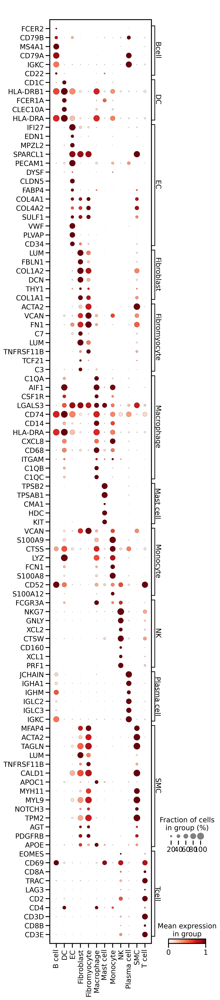

In [33]:
sc.pl.dotplot(
    adata,
    groupby="cell_type_level1",
    var_names=marker_genes_in_data,
    standard_scale="var",  # standard scale: normalize each gene to range from 0 to 1
    swap_axes = True
    #save="all_cells_level2_level1markers.png"
)

/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/icb/korbinian.traeuble/miniconda3/envs/jupyter-experimental/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No dat

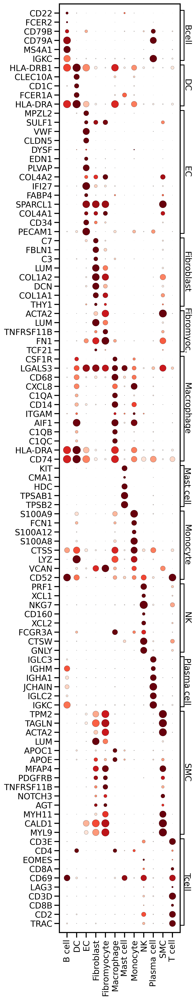

In [7]:
dp = sc.pl.dotplot(
    adata,
    groupby="cell_type_level1",
    var_names=marker_genes_in_data,
    standard_scale="var",  # standard scale: normalize each gene to range from 0 to 1
    return_fig = True,
    figsize = (4.5,30),
    swap_axes = True
    #save="surface_markers_fernandez_dendo.png"
)
dp.legend(width=0)
#dp.show()
dp.savefig("figures/dotplot_allcells-mse3-reload-level2-swap.pdf", format='pdf')

# Prepare for scPower

In [1]:
import scanpy as sc

In [9]:
adata_all = sc.read_h5ad("Altas_level2-noprototypes-allgenes-names-mse3-reload.h5ad")

In [11]:
adata_all.X = adata_all.layers["uncorrected_counts"]
# delete all layers
adata_all.layers = {}
del adata_all.uns["log1p"]

In [12]:
adata_all.write_h5ad("Altas_level2-noprototypes-allgenes-names-mse3-reload-scPower-uncorrected.h5ad")

In [7]:
adata_all.obs["cell_type_level1"].value_counts()

T cell          102741
Macrophage       24533
NK                9901
Monocyte          9293
SMC               9244
B cell            8987
EC                6589
Fibroblast        4663
Fibromyocyte      3520
Mast cell         1861
DC                1693
Plasma cell       1610
Name: cell_type_level1, dtype: int64

# Prepare for BayesPrism

In [2]:
adata_all = sc.read_h5ad("Altas_level2-noprototypes-allgenes-names-mse3-reload.h5ad")

In [3]:
#adata_all.X = adata_all.layers["rounded_corrected_counts"]
adata_all.X = adata_all.layers["uncorrected_counts"]
# delete all layers
adata_all.layers = {}
del adata_all.uns["log1p"]

In [5]:
adata_all.var.index = adata_all.var['ensembl_id']

In [7]:
adata_all.write("Altas_level2-noprototypes-allgenes-names-mse3-reload-Bayes-uncorrected.h5ad")

## new version with other EC subtypes

In [2]:
adata_all = sc.read_h5ad("Altas_level2-noprototypes-allgenes-names-mse3-reload-Bayes-uncorrected.h5ad")

In [3]:
adata_ec = sc.read_h5ad("tmp_ecs_adata_mse3-reload-level2-annot.h5ad")

In [5]:
# Extract barcodes and cell_type_level2 values
barcodes = adata_ec.obs_names
cell_types_level2 = adata_ec.obs["cell_type_level2"]

# Create the mapping
mapping = dict(zip(barcodes, cell_types_level2))

In [6]:
#change to str to edit
adata_all.obs['cell_type_level2'] = adata_all.obs['cell_type_level2'].astype(str)

In [7]:
# Update "cell_type_level2" in adata for matching barcodes
for barcode in adata_all.obs_names:
    if barcode in mapping:
        adata_all.obs.at[barcode, "cell_type_level2"] = mapping[barcode]

In [8]:
# remove the level 2 ECs which are unknown subcelltypes of ECs
adata_all = adata_all[adata_all.obs['cell_type_level2'] != 'ECs'].copy()

In [9]:
#change back to categorial
adata_all.obs['cell_type_level2'] = pd.Categorical(adata_all.obs['cell_type_level2'])

In [10]:
adata_all.obs['cell_type_level2'].value_counts()

cell_type_level2
CD4 TEff        86199
CD8             14548
Inflammatory    11006
NK               9901
Monocyte         9293
SMC              9244
B cell           8987
Foamy            8764
Resident         4763
Fibroblast       4663
Arterial ECs     3836
Fibromyocyte     3520
Venous ECs       2517
Mast cell        1861
CD4 Treg         1861
Plasma cell      1610
cDC2             1404
cDC1              289
CXCL8             133
Name: count, dtype: int64

In [11]:
#rename dict
rename_dict = {
    "CD4 TEff": "CD4 TEff T cell",
    "CD8": "CD8 T cell",
    "Inflammatory": "Inflammatory Macrophage",
    "NK" : "NK",
    "Monocyte": "Monocyte",
    "SMC": "SMC",
    "B cell": "B cell",
    "Foamy": "Foamy Macrophage",
    "Resident": "Resident Macrophage",
    "Fibroblast": "Fibroblast",
    "Arterial ECs": "Arterial EC",
    "Fibromyocyte": "Fibromyocyte",
    "Venous ECs": "Venous EC",
    "Mast cell": "Mast cell",
    "CD4 Treg" : "CD4 Treg T cell",
    "Plasma cell": "Plasma cell",
    "cDC2": "cDC2 Dentritic cell",
    "cDC1": "cDC1 Dentritic cell",
    "CXCL8": "CXCL8 T cell"
}

In [12]:
adata_all.obs['cell_type_level2'] = adata_all.obs['cell_type_level2'].map(rename_dict)

In [13]:
adata_all.obs['cell_type_level2'].value_counts()

cell_type_level2
CD4 TEff T cell            86199
CD8 T cell                 14548
Inflammatory Macrophage    11006
NK                          9901
Monocyte                    9293
SMC                         9244
B cell                      8987
Foamy Macrophage            8764
Resident Macrophage         4763
Fibroblast                  4663
Arterial EC                 3836
Fibromyocyte                3520
Venous EC                   2517
Mast cell                   1861
CD4 Treg T cell             1861
Plasma cell                 1610
cDC2 Dentritic cell         1404
cDC1 Dentritic cell          289
CXCL8 T cell                 133
Name: count, dtype: int64

In [17]:
adata_all.write("Altas_level2-noprototypes-allgenes-names-mse3-reload-Bayes-uncorrected-V2.h5ad")

## switching Arterial and venous annotation

In [2]:
adata = sc.read_h5ad("Altas_level2-noprototypes-allgenes-names-mse3-reload-Bayes-uncorrected-V2.h5ad")

In [3]:
adata.obs['cell_type_level2'].value_counts()

cell_type_level2
CD4 TEff T cell            86199
CD8 T cell                 14548
Inflammatory Macrophage    11006
NK                          9901
Monocyte                    9293
SMC                         9244
B cell                      8987
Foamy Macrophage            8764
Resident Macrophage         4763
Fibroblast                  4663
Arterial EC                 3836
Fibromyocyte                3520
Venous EC                   2517
Mast cell                   1861
CD4 Treg T cell             1861
Plasma cell                 1610
cDC2 Dentritic cell         1404
cDC1 Dentritic cell          289
CXCL8 T cell                 133
Name: count, dtype: int64

In [4]:
# Swap the labels
adata.obs['cell_type_level2'] = adata.obs['cell_type_level2'].replace({
    'Arterial EC': 'Venous EC',
    'Venous EC': 'Arterial EC'
})

In [5]:
adata.obs['cell_type_level2'].value_counts()

cell_type_level2
CD4 TEff T cell            86199
CD8 T cell                 14548
Inflammatory Macrophage    11006
NK                          9901
Monocyte                    9293
SMC                         9244
B cell                      8987
Foamy Macrophage            8764
Resident Macrophage         4763
Fibroblast                  4663
Venous EC                   3836
Fibromyocyte                3520
Arterial EC                 2517
Mast cell                   1861
CD4 Treg T cell             1861
Plasma cell                 1610
cDC2 Dentritic cell         1404
cDC1 Dentritic cell          289
CXCL8 T cell                 133
Name: count, dtype: int64

In [7]:
adata.write("Altas_level2-noprototypes-allgenes-names-mse3-reload-Bayes-uncorrected-V2-swap.h5ad")

## compare new EC annotations with old subtypes

In [18]:
adata_new = sc.read_h5ad("Altas_level2-noprototypes-allgenes-names-mse3-reload-Bayes-uncorrected-V2-swap.h5ad")

In [19]:
adata_old = sc.read_h5ad("Altas_level2-noprototypes-allgenes-names-mse3-reload-Bayes-uncorrected.h5ad")

In [20]:
adata_new

AnnData object with n_obs × n_vars = 184399 × 28488
    obs: 'dataset', 'cell_type', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'sample', 'scDblFinder.sample', 'scDblFinder.class', 'scDblFinder.score', 'scDblFinder.weighted', 'scDblFinder.cxds_score', 'decontX_contamination', 'decontX_clusters', 'symptoms', 'n_genes', 'n_counts', 'size_factors', 'cell_type_level1', 'cell_type_level2'
    var: 'original_gene_names', 'ensembl_id'

In [21]:
adata_old

AnnData object with n_obs × n_vars = 184635 × 28488
    obs: 'dataset', 'cell_type', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'sample', 'scDblFinder.sample', 'scDblFinder.class', 'scDblFinder.score', 'scDblFinder.weighted', 'scDblFinder.cxds_score', 'decontX_contamination', 'decontX_clusters', 'symptoms', 'n_genes', 'n_counts', 'size_factors', 'cell_type_level1', 'cell_type_level2'
    var: 'original_gene_names', 'ensembl_id'

In [22]:
adata_new_ec = adata_new[adata_new.obs["cell_type_level1"]=="EC"]

In [23]:
adata_new_ec.obs

,dataset,cell_type,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,sample,scDblFinder.sample,scDblFinder.class,scDblFinder.score,scDblFinder.weighted,scDblFinder.cxds_score,decontX_contamination,decontX_clusters,symptoms,n_genes,n_counts,size_factors,cell_type_level1,cell_type_level2
car02_d_CAATGACGTTGGACTT.1,Roche,EC A,1980.0,4890.0,465.0,9.509202,2_Roche,2,singlet,0.514602,1.000000,0.029204,0.130837,2-4,NaN,NaN,NaN,1.474705,EC,Venous EC
car02_d_CTCCAACAGGCTAACG.1,Roche,EC B,5748.0,30427.0,671.0,2.205278,2_Roche,2,singlet,0.659229,0.931253,0.358458,0.002526,2-4,NaN,NaN,NaN,9.559676,EC,Arterial EC
car02_d_TCTGGCTAGCCGATAG.1,Roche,EC A,5324.0,22687.0,894.0,3.940583,2_Roche,2,singlet,0.637373,0.893953,0.354747,0.010952,2-4,NaN,NaN,NaN,8.337678,EC,Venous EC
car03_d_CAATGACGTTGGACTT.1,Roche,EC A,3040.0,9357.0,684.0,7.310035,3_Roche,3,singlet,0.827072,1.000000,0.079652,0.441184,3-3,NaN,NaN,NaN,1.870882,EC,Venous EC
car03_d_CTCCAACAGGCTAACG.1,Roche,EC B,6877.0,44159.0,1030.0,2.332480,3_Roche,3,doublet,0.981448,1.000000,0.326610,0.377054,3-3,NaN,NaN,NaN,8.836741,EC,Arterial EC
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TGCTTCGTCCAGCACG-1_9,Slysz_femoral,NaN,2737.0,7962.0,199.0,2.499372,9_Slysz_femoral,9,singlet,0.000208,0.064473,0.046500,0.003234,9-8,not stated,2737.0,7962.0,2.460010,EC,Venous EC
TGGAACTCATCCAACA-1_9,Slysz_femoral,NaN,2237.0,5191.0,176.0,3.390484,9_Slysz_femoral,9,singlet,0.000069,0.097872,0.009808,0.004393,9-8,not stated,2237.0,5190.0,1.790839,EC,Venous EC
TGGTACATCAGGACGA-1_9,Slysz_femoral,NaN,1755.0,3932.0,150.0,3.814852,9_Slysz_femoral,9,singlet,0.000010,0.194862,0.010184,0.018509,9-8,not stated,1755.0,3932.0,1.233734,EC,Venous EC
TTAGGGTAGGTTAGTA-1_9,Slysz_femoral,NaN,2162.0,4974.0,267.0,5.367913,9_Slysz_femoral,9,singlet,0.000027,0.123644,0.016030,0.012437,9-8,not stated,2162.0,4974.0,1.684785,EC,Venous EC


In [24]:
adata_old_ec = adata_old[adata_old.obs["cell_type_level1"]=="EC"]

In [25]:
adata_old_ec.obs

,dataset,cell_type,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,sample,scDblFinder.sample,scDblFinder.class,scDblFinder.score,scDblFinder.weighted,scDblFinder.cxds_score,decontX_contamination,decontX_clusters,symptoms,n_genes,n_counts,size_factors,cell_type_level1,cell_type_level2
car02_d_CAATGACGTTGGACTT.1,Roche,EC A,1980.0,4890.0,465.0,9.509202,2_Roche,2,singlet,0.514602,1.000000,0.029204,0.130837,2-4,NaN,NaN,NaN,1.474705,EC,Proangiogenic
car02_d_CTCCAACAGGCTAACG.1,Roche,EC B,5748.0,30427.0,671.0,2.205278,2_Roche,2,singlet,0.659229,0.931253,0.358458,0.002526,2-4,NaN,NaN,NaN,9.559676,EC,EndoMT
car02_d_TCTGGCTAGCCGATAG.1,Roche,EC A,5324.0,22687.0,894.0,3.940583,2_Roche,2,singlet,0.637373,0.893953,0.354747,0.010952,2-4,NaN,NaN,NaN,8.337678,EC,Proangiogenic
car03_d_CAATGACGTTGGACTT.1,Roche,EC A,3040.0,9357.0,684.0,7.310035,3_Roche,3,singlet,0.827072,1.000000,0.079652,0.441184,3-3,NaN,NaN,NaN,1.870882,EC,Proangiogenic
car03_d_CTCCAACAGGCTAACG.1,Roche,EC B,6877.0,44159.0,1030.0,2.332480,3_Roche,3,doublet,0.981448,1.000000,0.326610,0.377054,3-3,NaN,NaN,NaN,8.836741,EC,EndoMT
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TGCTTCGTCCAGCACG-1_9,Slysz_femoral,NaN,2737.0,7962.0,199.0,2.499372,9_Slysz_femoral,9,singlet,0.000208,0.064473,0.046500,0.003234,9-8,not stated,2737.0,7962.0,2.460010,EC,Proangiogenic
TGGAACTCATCCAACA-1_9,Slysz_femoral,NaN,2237.0,5191.0,176.0,3.390484,9_Slysz_femoral,9,singlet,0.000069,0.097872,0.009808,0.004393,9-8,not stated,2237.0,5190.0,1.790839,EC,Proangiogenic
TGGTACATCAGGACGA-1_9,Slysz_femoral,NaN,1755.0,3932.0,150.0,3.814852,9_Slysz_femoral,9,singlet,0.000010,0.194862,0.010184,0.018509,9-8,not stated,1755.0,3932.0,1.233734,EC,Proangiogenic
TTAGGGTAGGTTAGTA-1_9,Slysz_femoral,NaN,2162.0,4974.0,267.0,5.367913,9_Slysz_femoral,9,singlet,0.000027,0.123644,0.016030,0.012437,9-8,not stated,2162.0,4974.0,1.684785,EC,Proangiogenic


In [26]:
import seaborn as sns

# Extract labels for common cells
common_cells = adata_old_ec.obs_names.intersection(adata_new_ec.obs_names)
old_labels = adata_old_ec.obs.loc[common_cells, 'cell_type_level2']
new_labels = adata_new_ec.obs.loc[common_cells, 'cell_type_level2']

matrix = pd.crosstab(old_labels, new_labels)

print(matrix)

cell_type_level2  Arterial EC  Venous EC
cell_type_level2                        
EndoMT                   2109         43
Intimal                   343        332
Lymphatic                  43         68
Proangiogenic              22       3393


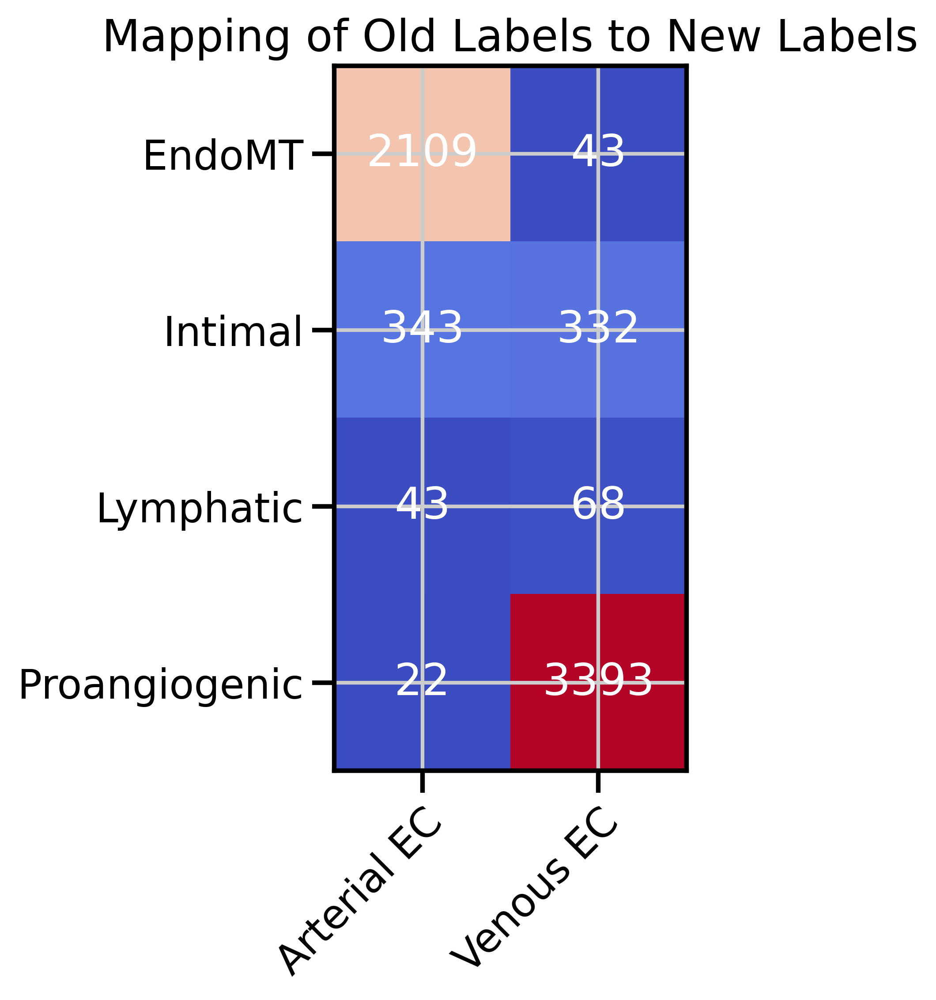

In [29]:
# ignore the variable names
# Define the labels for the rows and columns based on your specific data
vegetables = ["EndoMT", "Intimal", "Lymphatic", "Proangiogenic"]
farmers = ["Arterial EC", "Venous EC"]

# Your specific data matrix (assuming this is your harvest matrix with different labels)
harvest = np.array([
    [2109, 43],
    [343, 332],
    [43, 68],
    [22, 3393]
])

fig, ax = plt.subplots(figsize=(8, 6))  # Adjust the size as needed

# Heatmap data visualisation
im = ax.imshow(harvest, cmap="coolwarm")

# Show all ticks...
ax.set_xticks(np.arange(len(farmers)))
ax.set_yticks(np.arange(len(vegetables)))

# ... and label them with the respective list entries
ax.set_xticklabels(farmers)
ax.set_yticklabels(vegetables)

# Rotate the tick labels and set their alignment.
plt.setp(ax.get_xticklabels(), rotation=45, ha="right", rotation_mode="anchor")

# Loop over data dimensions and create text annotations.
for i in range(len(vegetables)):
    for j in range(len(farmers)):
        ax.text(j, i, harvest[i, j], ha="center", va="center", color="w")

# Set the title
ax.set_title("Mapping of Old Labels to New Labels")

# Improve the layout
fig.tight_layout()

# Show the plot
#plt.show()
plt.savefig("figures/mappingECs.png")

## New SMC/Fibro subtypes and swapped ECs

In [31]:
adata_all = sc.read_h5ad("Altas_level2-noprototypes-allgenes-names-mse3-reload-Bayes-uncorrected-V2-swap.h5ad")

In [32]:
adata_smc = sc.read_h5ad("tmp_fibsmc_adata_mse3-reload-level2-annot-miller.h5ad")

In [33]:
# Extract barcodes and cell_type_level2 values
barcodes = adata_smc.obs_names
cell_types_level2 = adata_smc.obs["cell_type_level2"]

# Create the mapping
mapping = dict(zip(barcodes, cell_types_level2))

In [34]:
#change to str to edit
adata_all.obs['cell_type_level2'] = adata_all.obs['cell_type_level2'].astype(str)

# Update "cell_type_level2" in adata for matching barcodes
for barcode in adata_all.obs_names:
    if barcode in mapping:
        adata_all.obs.at[barcode, "cell_type_level2"] = mapping[barcode]

# remove the level 2 SMCs which are unknown subcelltypes of SMCs
adata_all = adata_all[adata_all.obs['cell_type_level2'] != 'unknown'].copy()

#change back to categorial
adata_all.obs['cell_type_level2'] = pd.Categorical(adata_all.obs['cell_type_level2'])

In [35]:
adata_all.obs['cell_type_level2'].value_counts()

cell_type_level2
CD4 TEff T cell            86199
CD8 T cell                 14548
Inflammatory Macrophage    11006
NK                          9901
Monocyte                    9293
B cell                      8987
Foamy Macrophage            8764
Resident Macrophage         4763
Venous EC                   3836
Contractile SMC             3783
Fibroblast                  3180
Fibromyocyte                3012
Pericyte                    2791
Arterial EC                 2517
Mast cell                   1861
CD4 Treg T cell             1861
Plasma cell                 1610
cDC2 Dentritic cell         1404
Modulated SMC               1125
Fibrochondrocyte             995
Foam-like SMC                886
cDC1 Dentritic cell          289
SMC 2                        171
CXCL8 T cell                 133
Name: count, dtype: int64

In [36]:
adata_all.write("Altas_level2-noprototypes-allgenes-names-mse3-reload-Bayes-uncorrected-V3-miller-ECswap.h5ad")